In [1]:
import os
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
from collections import OrderedDict

from src.visualizations import * 
from src.statistical_tests import *
from src.fairness import kl, cheb, tv, chi 
from src.fairness import compute_RDP, compute_PR, compute_UCPR 
from src.evaluation import compute_losses, compute_diversity 

C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# 1. Loading all Images 

In [2]:
METHODS = ["pulse", "psp", "fairpsp", "posteriorSampling",  "ddrm"] 
RACES = ["White", 
       "Indian", 
       "Black", 
       "Latino_Hispanic",
       "Southeast Asian",
       "East Asian",
       "Middle Eastern"]

In [3]:
img_paths = {"fairface": {method: f"upsampled_imgs/fairface/16_to_128/{method}/" for method in METHODS}, 
             "fairface_avg": {method: f"upsampled_imgs/fairface/4_to_128/{method}/" for method in METHODS},
             "fairface_noisy_avg": {method: f"upsampled_imgs/fairface/4noise_to_128/{method}/" for method in METHODS},
             "unfairface": {method: f"upsampled_imgs/unfairface/16_to_128/{method}/" for method in METHODS},
             "unfairface_avg": {method: f"upsampled_imgs/unfairface/4_to_128/{method}/" for method in METHODS},
              "unfairface_noisy_avg": {method: f"upsampled_imgs/unfairface/4noise_to_128/{method}/" for method in METHODS},
             }

labels_path = "data/fairface/fairface_label_val.csv"
real_img_path = "data/fairface/test_correct_prediction/"
img_paths["fairface"]["real"] = real_img_path 
img_paths["unfairface"]["real"] = real_img_path 
avg_img_path = "data/fairface/avg_faces/"
img_paths["fairface_avg"]["real"] = avg_img_path
img_paths["unfairface_avg"]["real"] = avg_img_path 
noisy_avg_img_path = "data/fairface/avg_noisy_faces/"
img_paths["fairface_noisy_avg"]["real"] = noisy_avg_img_path
img_paths["unfairface_noisy_avg"]["real"] = noisy_avg_img_path 

# lr images are computed on the fly 
img_paths["fairface"]["lr"] = ""
img_paths["unfairface"]["lr"] = ""
img_paths["fairface_avg"]["lr"] = ""
img_paths["unfairface_avg"]["lr"] = ""
img_paths["fairface_noisy_avg"]["lr"] = ""
img_paths["unfairface_noisy_avg"]["lr"] = ""

# reorder the paths such that the keys()-order is Original - LR - PULSE - etc 
# Swap the last two keys to the front
keys = ["real", "lr"] + METHODS
for dataset_name in img_paths.keys():
    img_paths[dataset_name] = OrderedDict((key, img_paths[dataset_name][key]) for key in keys)

# 2. Qualitative Results

In [4]:
os.makedirs("plots/reconstructions", exist_ok=True)

## 2.1. Visualize Random Reconstructions 

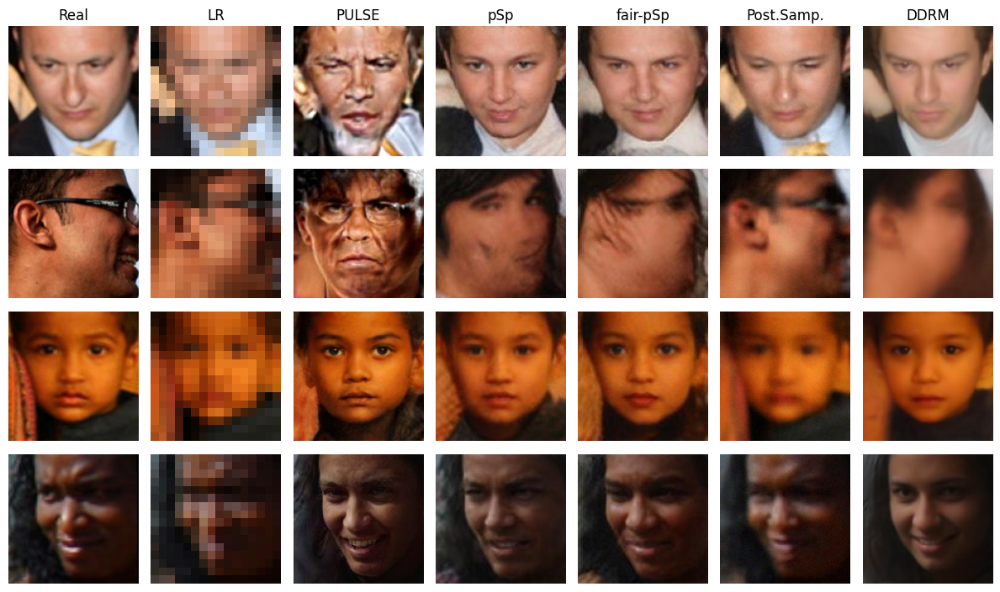

In [5]:
# Unfairface: 
visualize_reconstructions(img_paths["unfairface"], num_imgs=4)

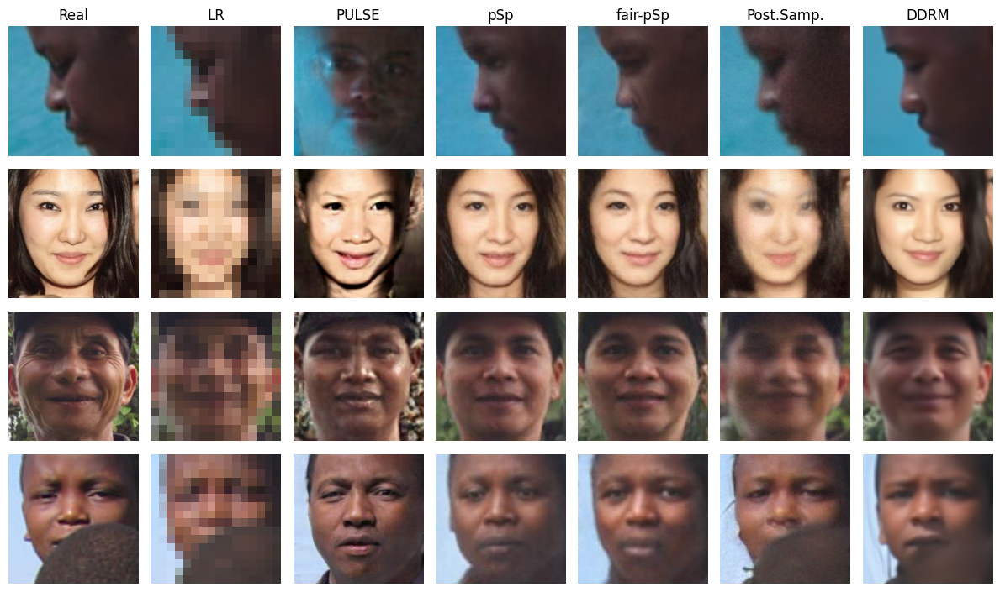

In [6]:
# Fairface: 
visualize_reconstructions(img_paths["fairface"], num_imgs=4)

C:\Users\hoand\PycharmProjects\ditmeKhoiNguyen\Benchmarking-Fairness-ImageUpsampling\src\visualizations.py:153: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


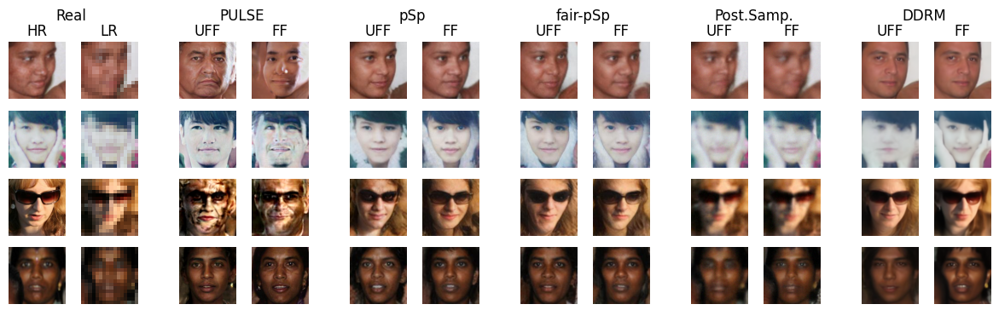

In [7]:
# UnfairFace vs FairFace 
visualize_reconstructions_comparison(img_paths["unfairface"], img_paths["fairface"], num_imgs=4)

### Teaser Image: 

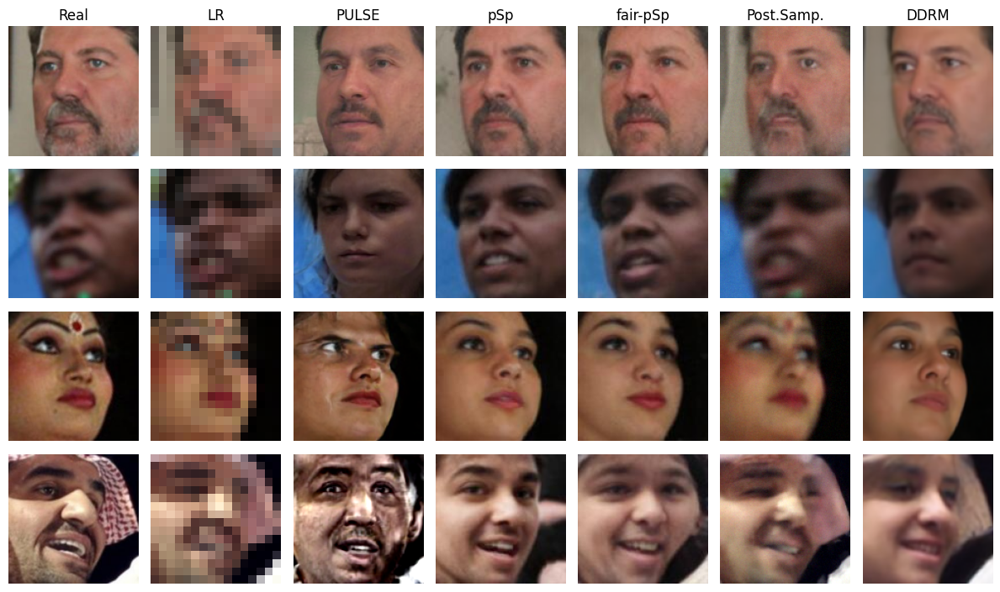

In [8]:
img_names_teaser = ["22.jpg", "106.jpg", "118.jpg", "511.jpg"]
visualize_reconstructions(img_paths["unfairface"], img_names=img_names_teaser)
plt.savefig("plots/reconstructions/teaser_unfairface.pdf")

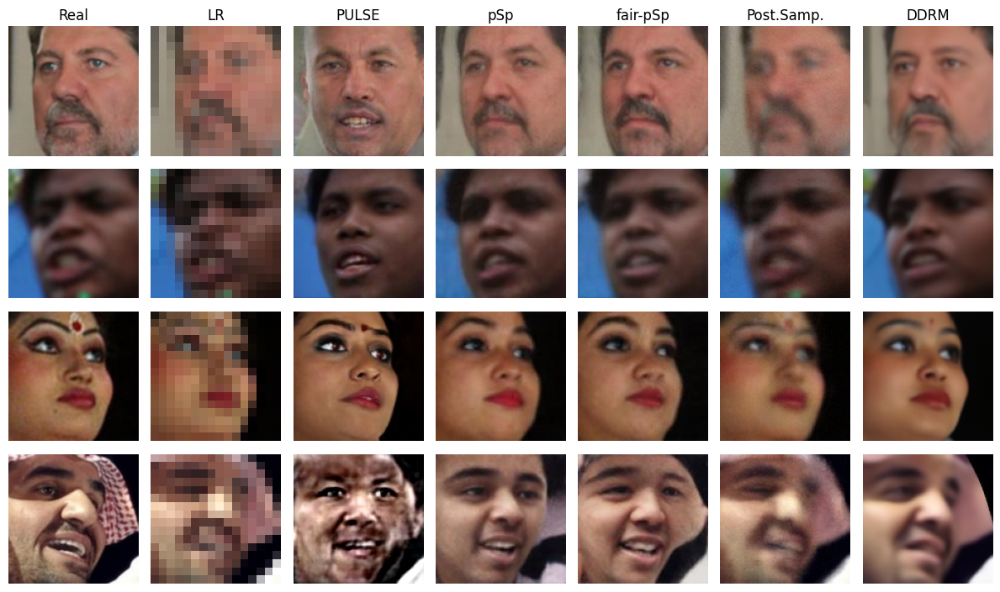

In [9]:
img_names_teaser = ["22.jpg", "106.jpg", "118.jpg", "511.jpg"]
visualize_reconstructions(img_paths["fairface"], img_names=img_names_teaser)
plt.savefig("plots/reconstructions/teaser_fairface.pdf")

## 2.2. Visualize Samples from a specific Ethnicity 

In [10]:
labels_df = pd.read_csv(labels_path)

def return_img_names_in_test_set(test_set_dir, race="White", num_imgs=8):
    """Reads the labels file and returns the image names of a specific race."""
    img_names = list(labels_df["file"][labels_df["race"]==race])
    filenames_test = os.listdir(test_set_dir)
    img_names_return = []
    index = 0
    while len(img_names_return) < num_imgs:
        img_name = img_names[index].split("/")[-1]
        if img_name in filenames_test:
            img_names_return.append(img_name)
        index += 1 
    return img_names_return 

img_names_black = return_img_names_in_test_set(img_paths["fairface"]["real"], "Black", num_imgs=12)
img_names_white = return_img_names_in_test_set(img_paths["fairface"]["real"], "White", num_imgs=4)
img_names_indian = return_img_names_in_test_set(img_paths["fairface"]["real"], "Indian", num_imgs=12)
img_names_me = return_img_names_in_test_set(img_paths["fairface"]["real"], "Middle Eastern", num_imgs=12)
img_names_ea = return_img_names_in_test_set(img_paths["fairface"]["real"], "East Asian", num_imgs=12)
img_names_sea = return_img_names_in_test_set(img_paths["fairface"]["real"], "Southeast Asian", num_imgs=12)
img_names_lh = return_img_names_in_test_set(img_paths["fairface"]["real"], "Latino_Hispanic", num_imgs=12)

# cherry-picked images
img_names_black_selected = [img_names_black[j] for j in [2, 7, 8]]
img_names_indian_selected = [img_names_indian[j] for j in [1, 4, 8]] 
img_names_me_selected = [img_names_me[j] for j in [0, 6, 11]]
img_names_ea_selected = [img_names_ea[j] for j in [0, 6, 9]] 
img_names_sea_selected = [img_names_sea[j] for j in [1, 4, 10]] 
img_names_lh_selected = [img_names_lh[j] for j in [1, 4, 5]]

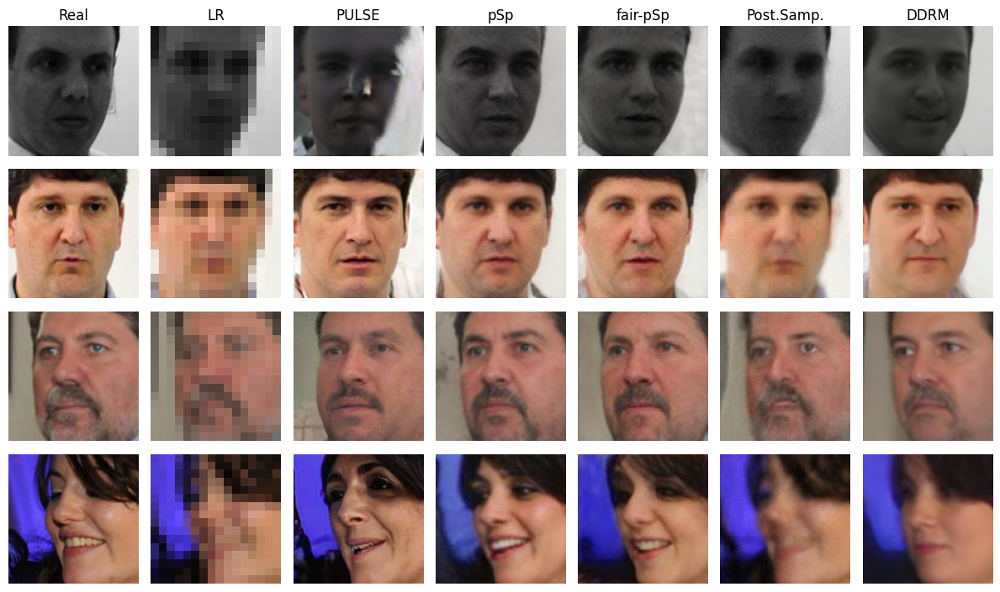

In [11]:
visualize_reconstructions(img_paths["unfairface"], img_names=img_names_white)
plt.savefig("plots/reconstructions/white_unfairface.pdf")

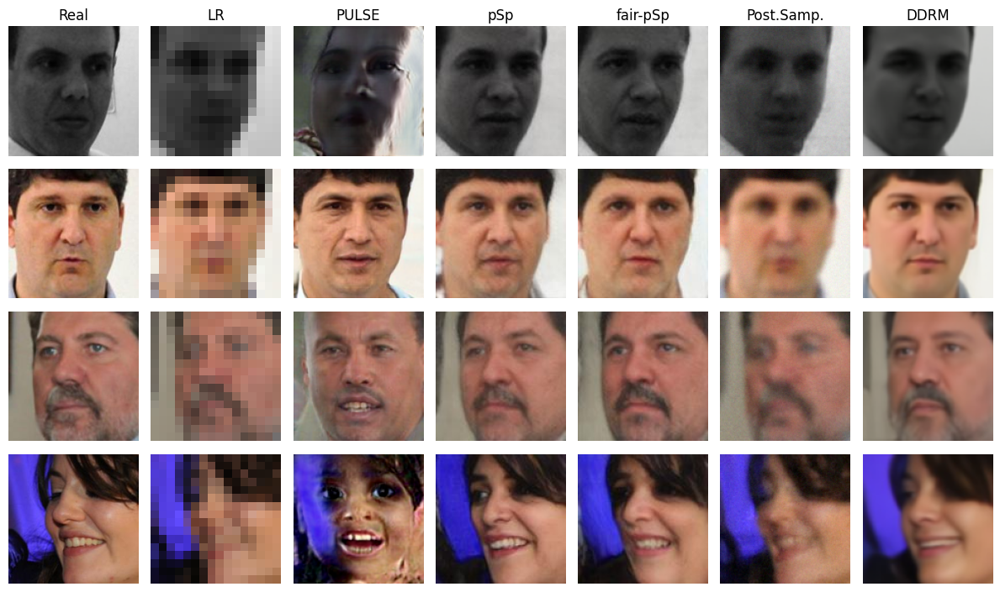

In [12]:
visualize_reconstructions(img_paths["fairface"], img_names=img_names_white)
plt.savefig("plots/reconstructions/white_fairface.pdf")

C:\Users\hoand\PycharmProjects\ditmeKhoiNguyen\Benchmarking-Fairness-ImageUpsampling\src\visualizations.py:153: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


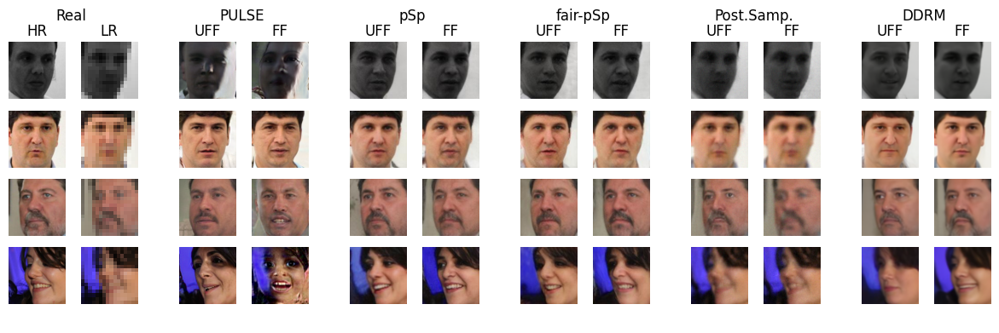

In [17]:
visualize_reconstructions_comparison(img_paths["unfairface"], img_paths["fairface"], img_names=img_names_white )
plt.savefig("plots/reconstructions/comparison_white.pdf")


### Black 

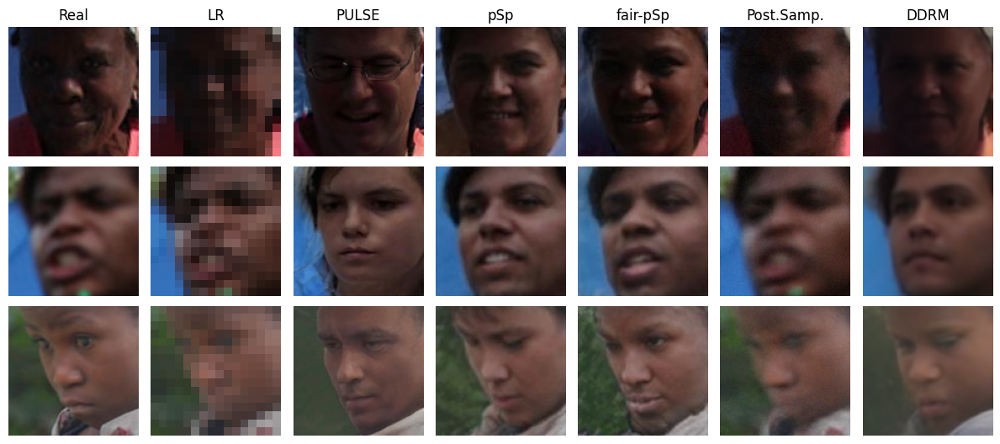

In [18]:
visualize_reconstructions(img_paths["unfairface"], img_names=img_names_black_selected)
plt.savefig("plots/reconstructions/black_unfairface.pdf")

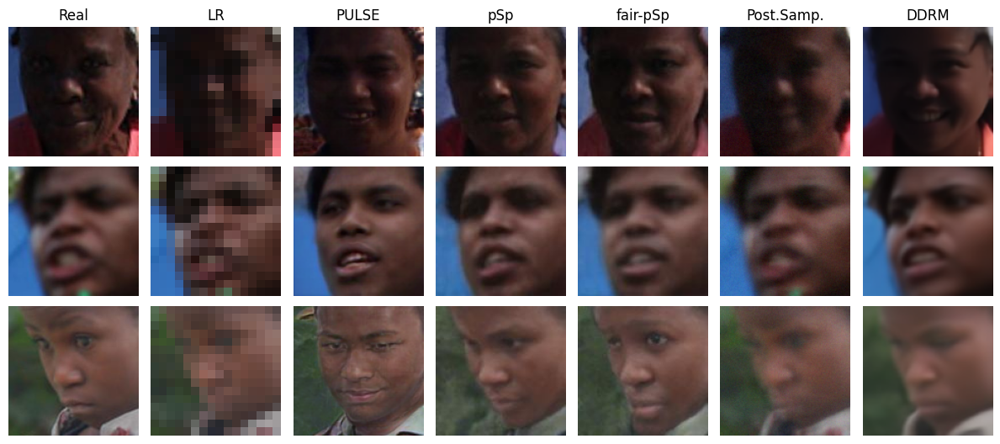

In [15]:
visualize_reconstructions(img_paths["fairface"], img_names=img_names_black_selected)
plt.savefig("plots/reconstructions/black_fairface.pdf")

C:\Users\hoand\PycharmProjects\ditmeKhoiNguyen\Benchmarking-Fairness-ImageUpsampling\src\visualizations.py:153: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


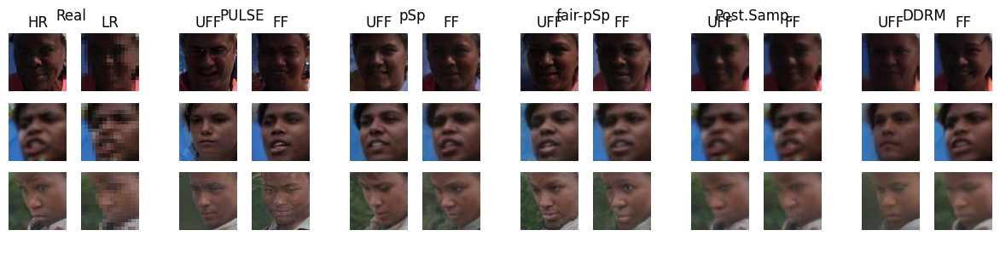

In [19]:
visualize_reconstructions_comparison(img_paths["unfairface"], img_paths["fairface"], img_names=img_names_black_selected)
plt.savefig("plots/reconstructions/comparison_black.pdf")

### Plot More Headscarves, Bindis, and Monolid Eyes

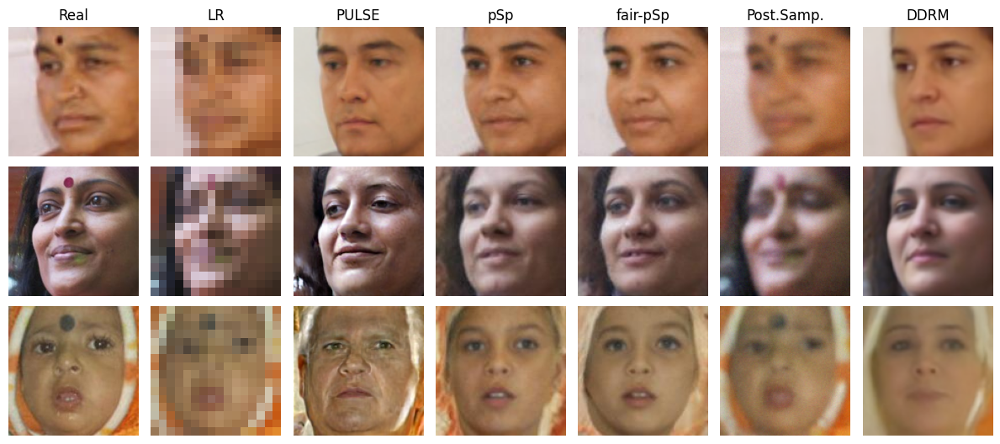

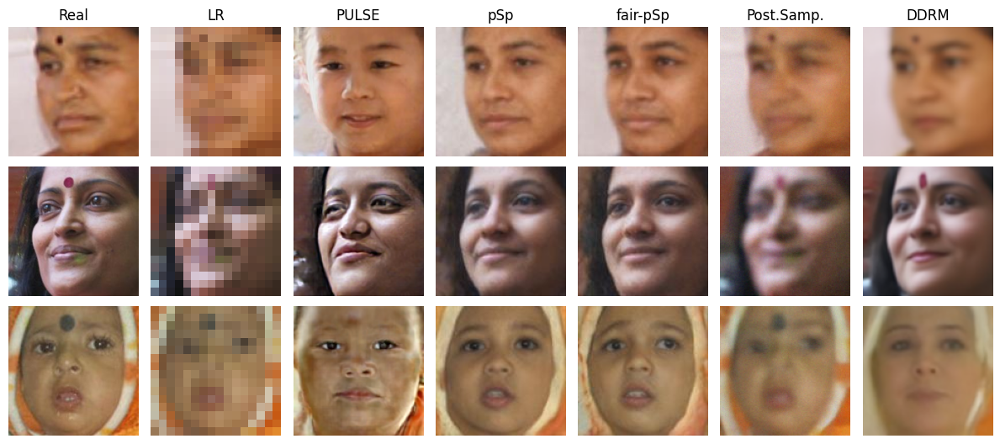

In [20]:
img_names_bindis = [f"{nr}.jpg" for nr in [136, 900, 1637]] 
visualize_reconstructions(img_paths["unfairface"], img_names=img_names_bindis)
plt.savefig("plots/reconstructions/bindis_unfairface.pdf")

visualize_reconstructions(img_paths["fairface"], img_names=img_names_bindis)
plt.savefig("plots/reconstructions/bindis_fairface.pdf")

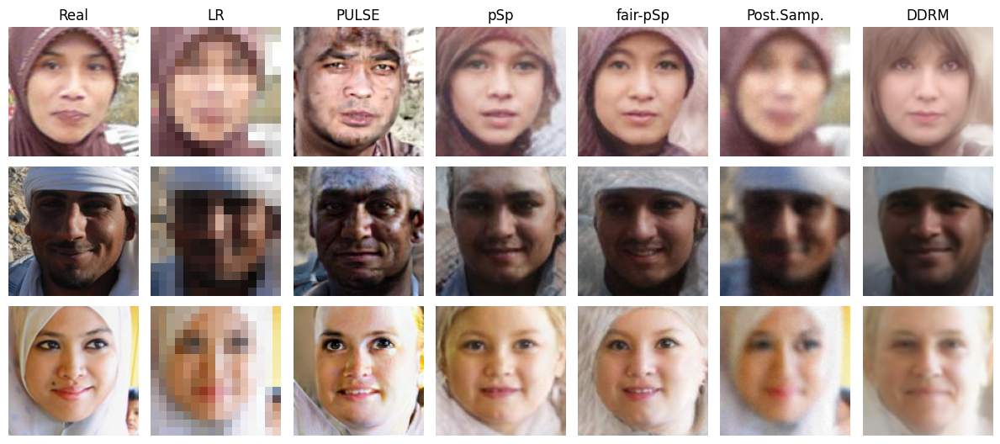

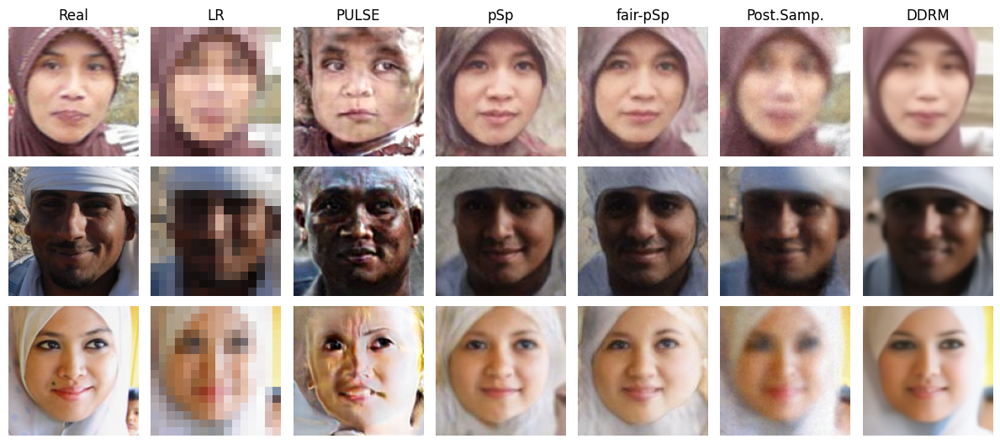

In [21]:
img_names_scarves = [f"{nr}.jpg" for nr in [1214, 1404, 1901]] 
visualize_reconstructions(img_paths["unfairface"], img_names=img_names_scarves)
plt.savefig("plots/reconstructions/scarves_unfairface.pdf")

visualize_reconstructions(img_paths["fairface"], img_names=img_names_scarves)
plt.savefig("plots/reconstructions/scarves_fairface.pdf")

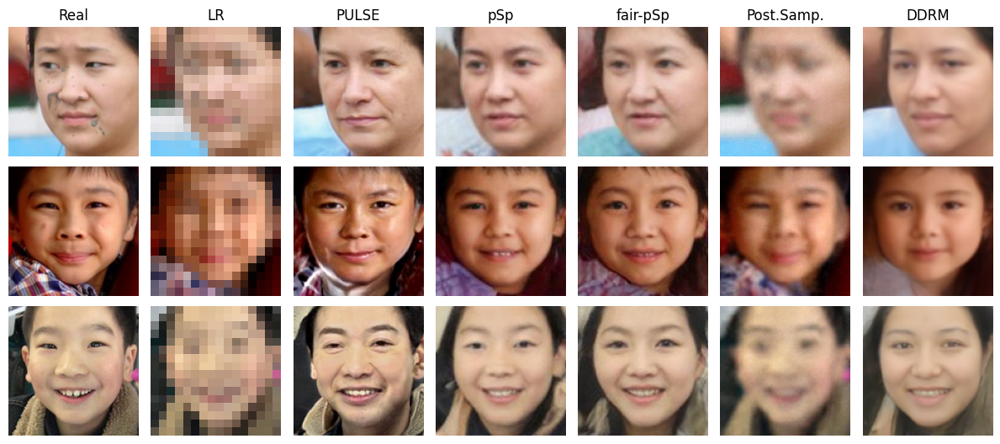

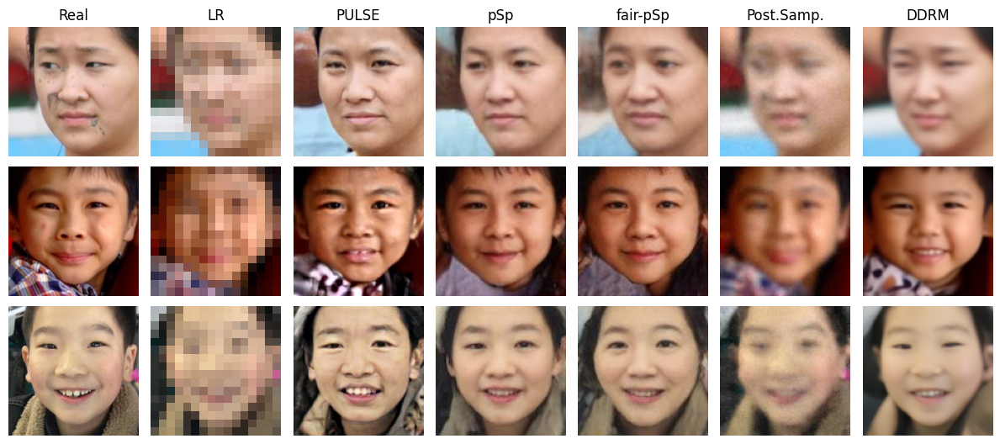

In [22]:
img_names_monolid = [f"{nr}.jpg" for nr in [138, 346, 399]] 
visualize_reconstructions(img_paths["unfairface"], img_names=img_names_monolid)
plt.savefig("plots/reconstructions/monolid_unfairface.pdf")

visualize_reconstructions(img_paths["fairface"], img_names=img_names_monolid)
plt.savefig("plots/reconstructions/monolid_fairface.pdf")

### Remaining Races:

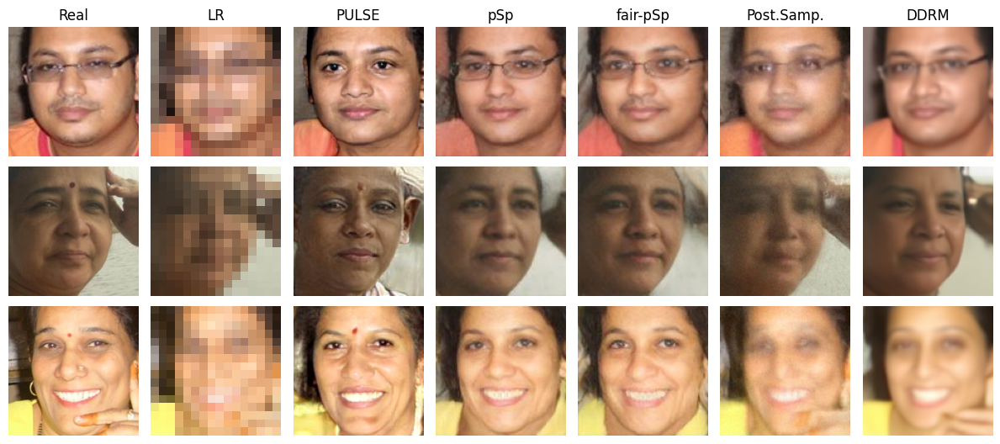

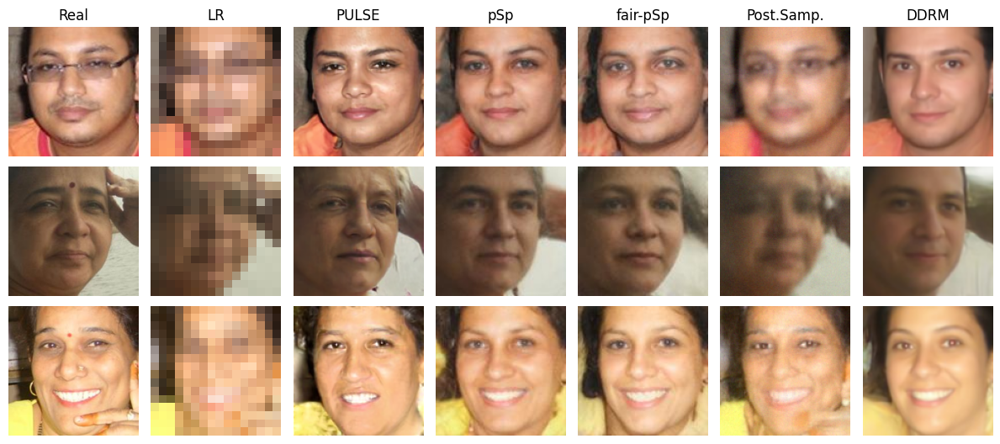

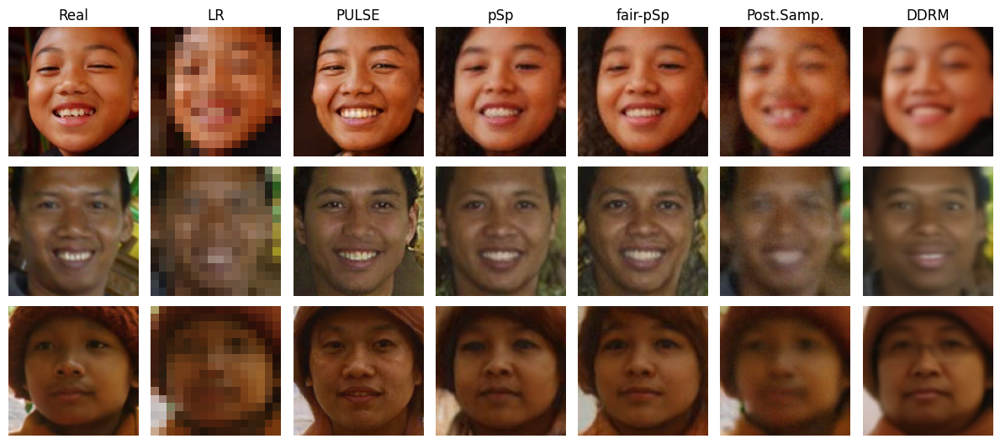

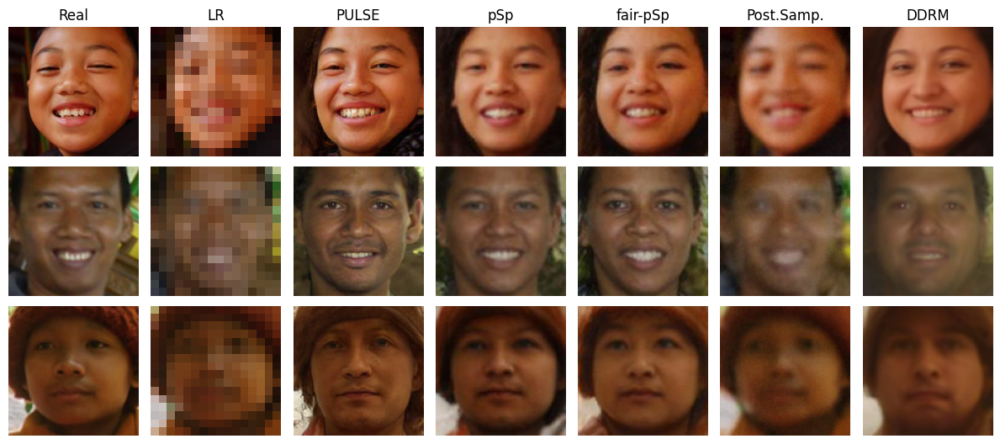

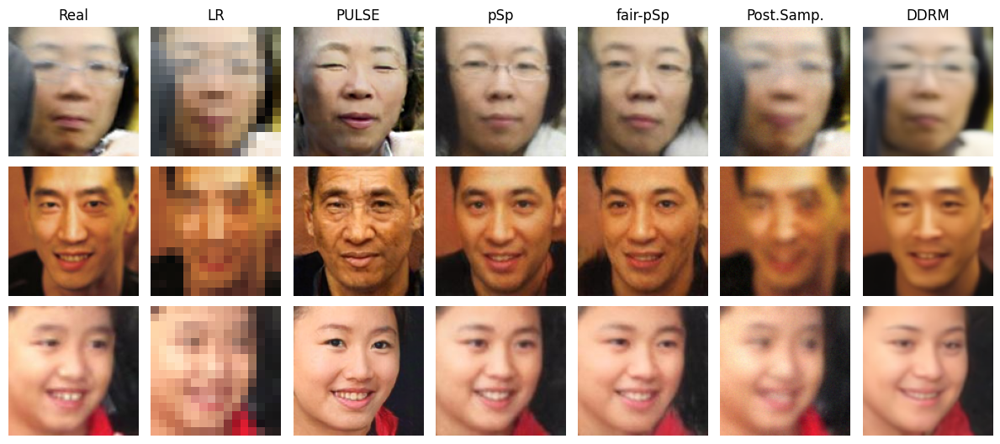

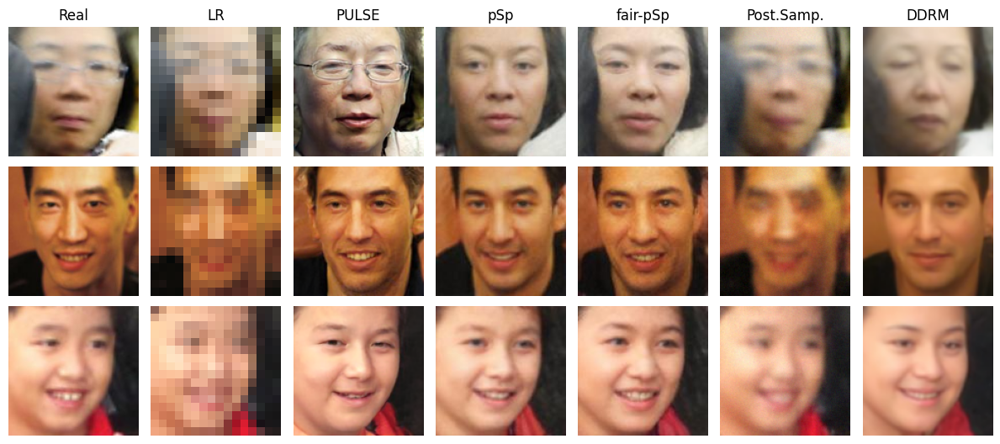

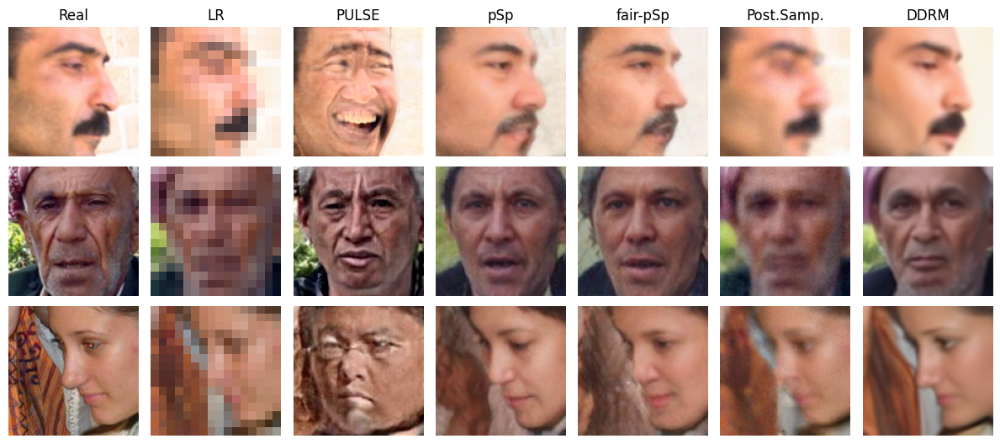

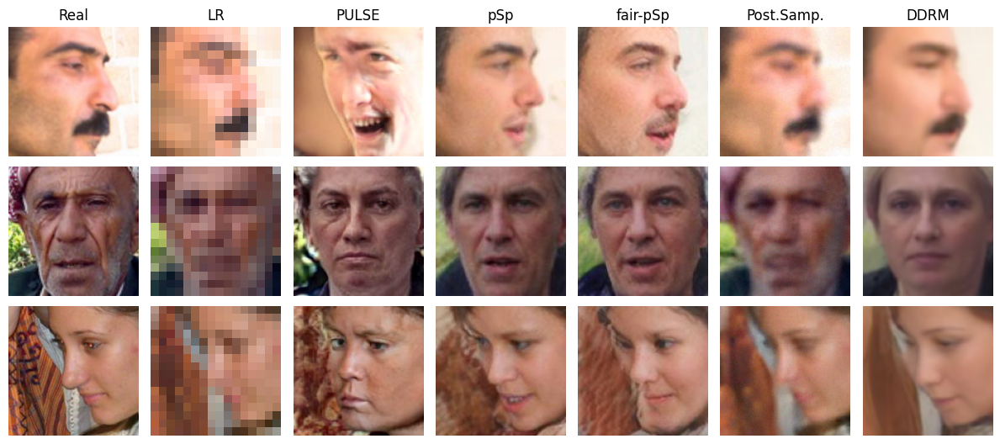

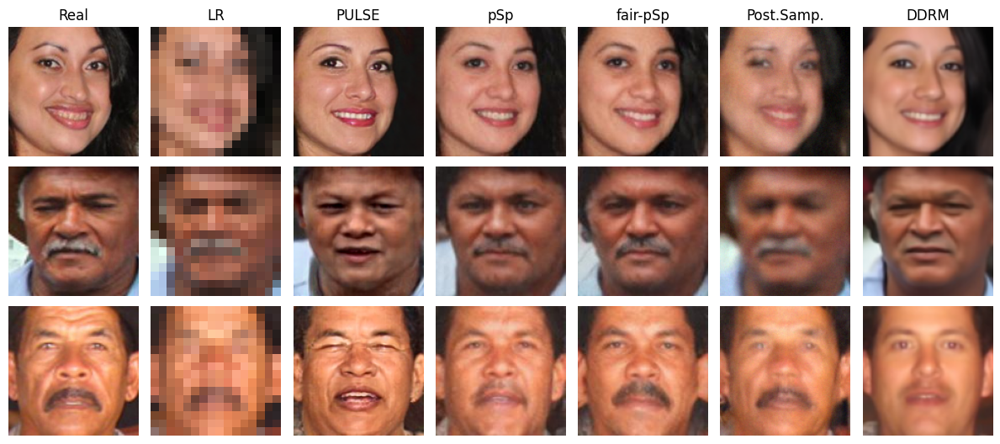

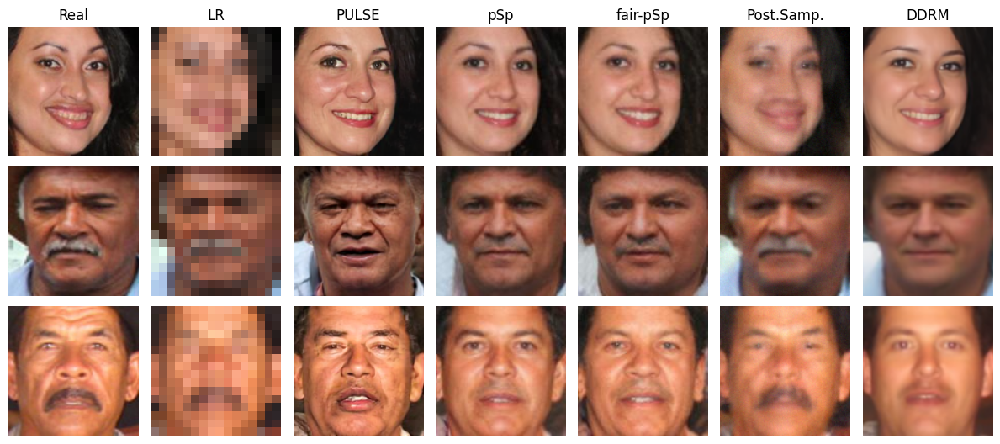

In [23]:
dict_race2img = {"Indian": img_names_indian_selected, 
                "Southeast Asian": img_names_sea_selected,
                "East Asian": img_names_ea_selected,
                "Middle Eastern": img_names_me_selected,
                "Latino_Hispanic": img_names_lh_selected}

for race in ["Indian", "Southeast Asian", "East Asian", "Middle Eastern", "Latino_Hispanic"]:
    img_names = dict_race2img[race]
    visualize_reconstructions(img_paths["fairface"], img_names=img_names)
    plt.savefig(f"plots/reconstructions/{race}_fairface.pdf")
    visualize_reconstructions(img_paths["unfairface"], img_names=img_names)
    plt.savefig(f"plots/reconstructions/{race}_unfairface.pdf")

## 2.3. Visualize multiple Samples given LowRes Downsampled to 4x4

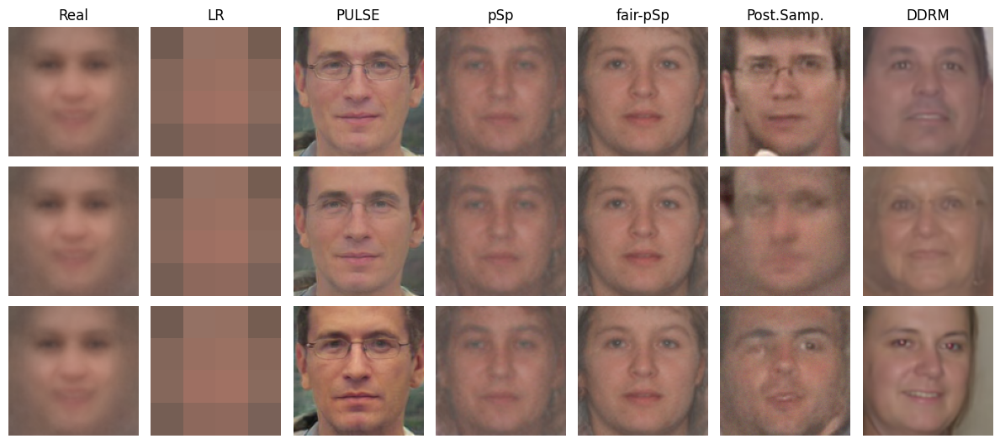

In [24]:
visualize_reconstructions_avg(img_paths["unfairface_avg"], race="White", num_imgs=3)
plt.savefig("plots/reconstructions/white_unfairface_avg.pdf")

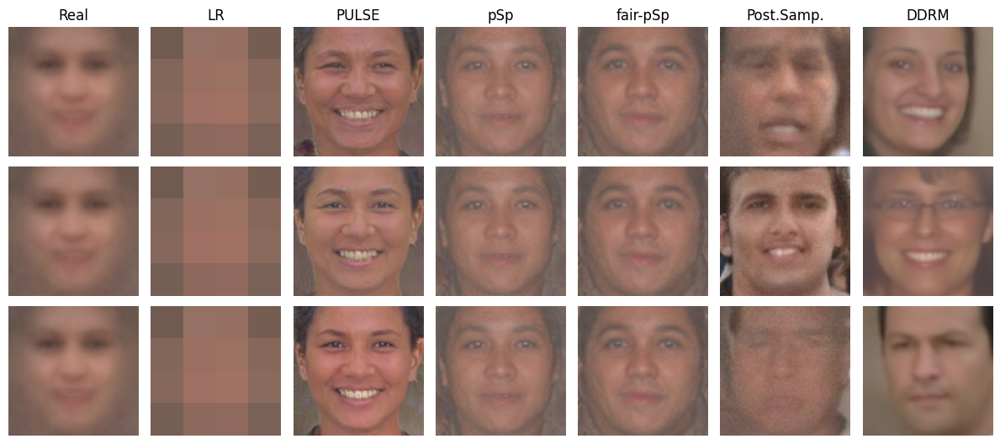

In [25]:
visualize_reconstructions_avg(img_paths["fairface_avg"], race="White", num_imgs=3)
plt.savefig("plots/reconstructions/white_fairface_avg.pdf")

C:\Users\hoand\PycharmProjects\ditmeKhoiNguyen\Benchmarking-Fairness-ImageUpsampling\src\visualizations.py:269: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


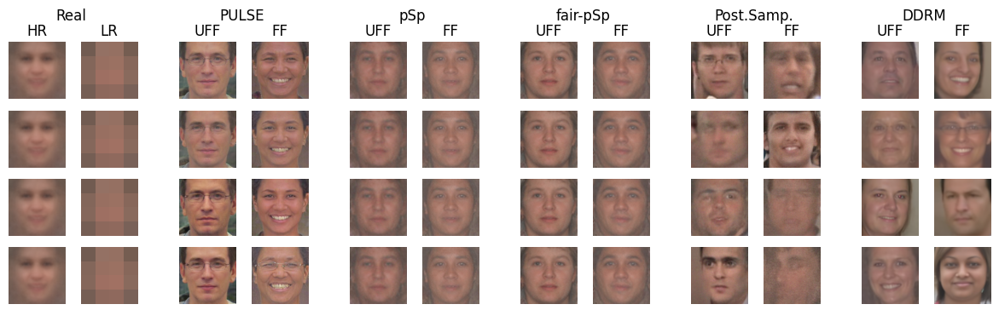

In [26]:
visualize_reconstructions_avg_comparison(img_paths["unfairface_avg"], img_paths["fairface_avg"], race="White", num_imgs=4)

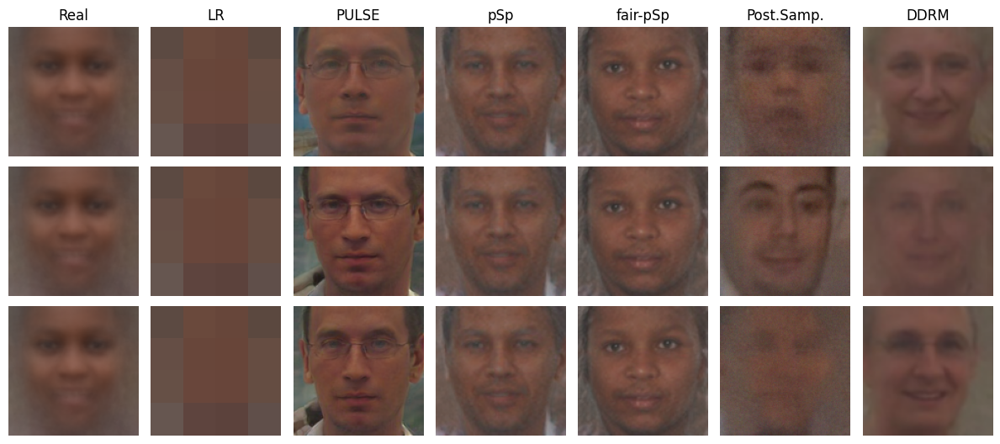

In [27]:
visualize_reconstructions_avg(img_paths["unfairface_avg"], race="Black", num_imgs=3)
plt.savefig("plots/reconstructions/black_unfairface_avg.pdf")

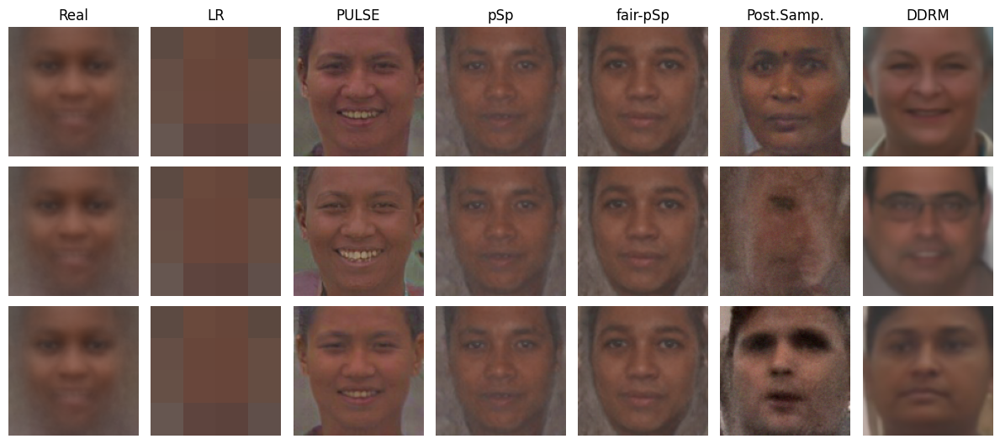

In [28]:
visualize_reconstructions_avg(img_paths["fairface_avg"], race="Black", num_imgs=3)
plt.savefig("plots/reconstructions/black_fairface_avg.pdf")

C:\Users\hoand\PycharmProjects\ditmeKhoiNguyen\Benchmarking-Fairness-ImageUpsampling\src\visualizations.py:269: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


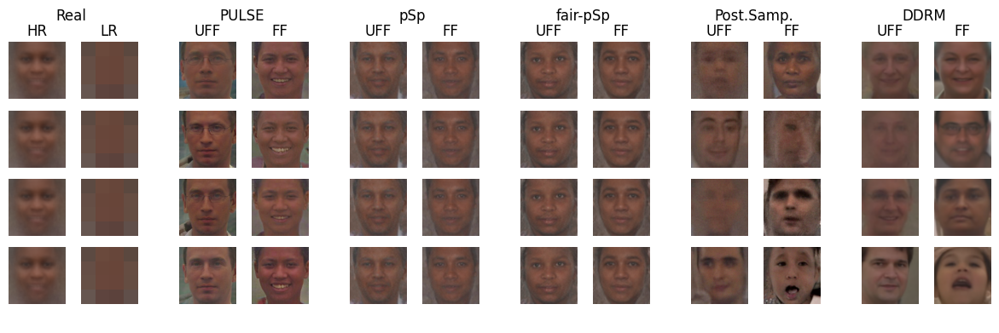

In [29]:
visualize_reconstructions_avg_comparison(img_paths["unfairface_avg"], img_paths["fairface_avg"], race="Black", num_imgs=4)

### Noisy Averages as Input:

In [30]:
path_avg = img_paths["unfairface_avg"]["real"]
print(path_avg)

data/fairface/avg_faces/


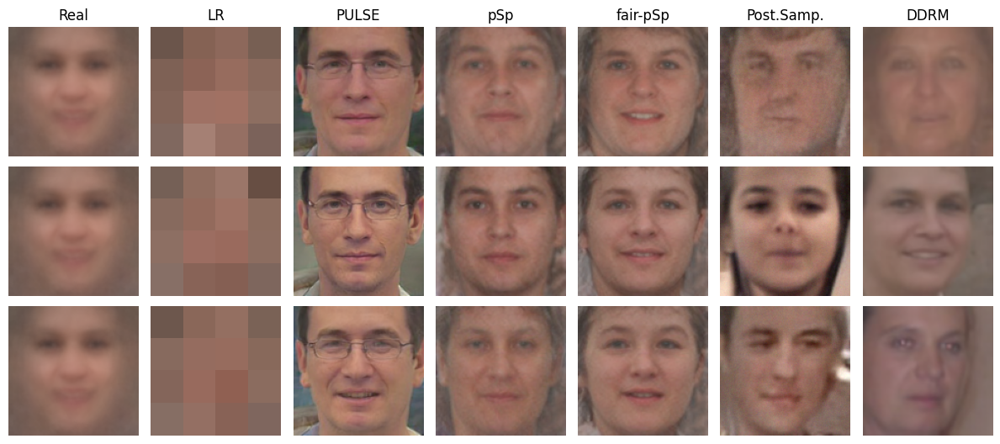

In [31]:
visualize_reconstructions_noisy_avg(img_paths["unfairface_noisy_avg"], path_avg=path_avg, race="White", num_imgs=3)
plt.savefig("plots/reconstructions/white_unfairface_noisy_avg.pdf")

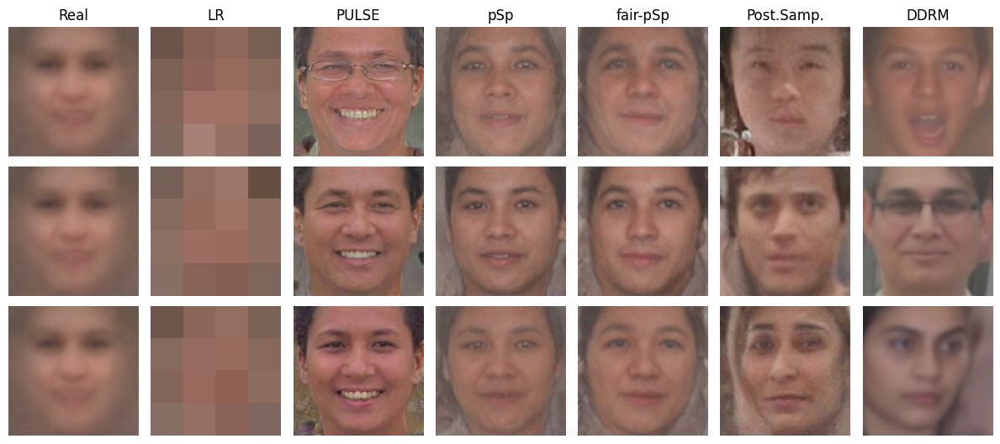

In [32]:
visualize_reconstructions_noisy_avg(img_paths["fairface_noisy_avg"], path_avg=path_avg, race="White", num_imgs=3)
plt.savefig("plots/reconstructions/white_fairface_noisy_avg.pdf")

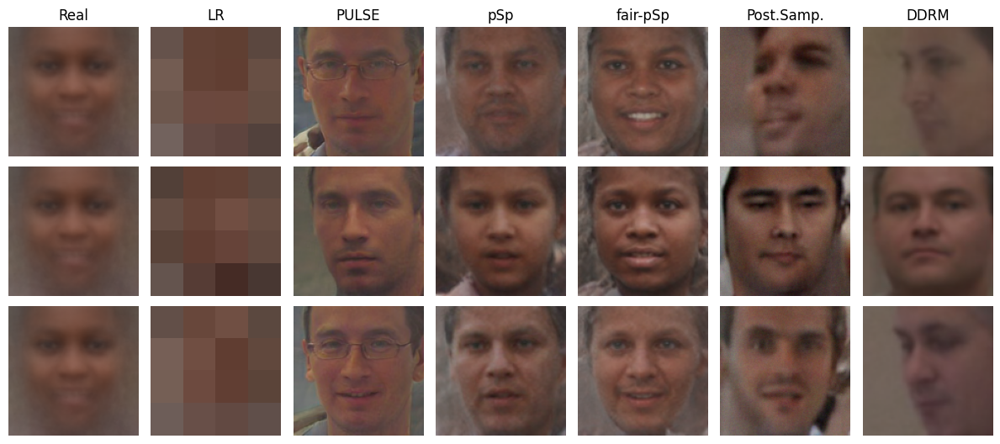

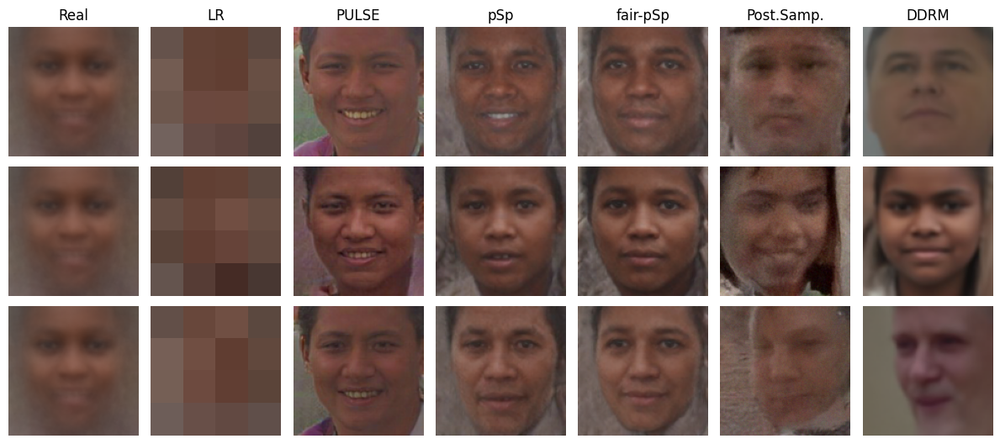

In [33]:
visualize_reconstructions_noisy_avg(img_paths["unfairface_noisy_avg"], path_avg=path_avg, race="Black", num_imgs=3)
plt.savefig("plots/reconstructions/black_unfairface_noisy_avg.pdf")
visualize_reconstructions_noisy_avg(img_paths["fairface_noisy_avg"], path_avg=path_avg, race="Black", num_imgs=3)
plt.savefig("plots/reconstructions/black_fairface_noisy_avg.pdf")

# 3. Quantitative Results
## 3.1. Calculate all Losses and obtain Losses-DFs 

In [34]:

def losses_to_dfs(setting):
    """Returns a dict of loss dfs. Each df contains the losses for a specific method."""
    assert setting in ["fairface", "unfairface"]
    losses_dir = os.path.join("evaluation", setting) 
    os.makedirs(losses_dir, exist_ok=True)
    dfs = {}
    for method in METHODS: 
        losses_path = os.path.join(losses_dir, f"losses_{method}.csv")
        if os.path.exists(losses_path):
            dfs[method] = pd.read_csv(losses_path)
        else:
            df = compute_losses(img_paths[setting]["real"], img_paths[setting][method], labels_path=labels_path)
            dfs[method] = df
            df.to_csv(losses_path, index=True)
    return dfs 
      
dfs = {}      
for setting in ["fairface", "unfairface"]:
    dfs[setting] = losses_to_dfs(setting)
    
print(dfs["fairface"]["pulse"].head())

   Unnamed: 0          file             race  race_id     lpips      ssim  \
0           0    val/10.jpg  Southeast Asian        2  0.085500  0.158675   
1           1   val/100.jpg       East Asian        2  0.261449  0.287648   
2           2  val/1001.jpg  Southeast Asian        2  0.367500  0.200556   
3           3  val/1006.jpg            Black        2  0.266021  0.277903   
4           4  val/1009.jpg       East Asian        2  0.110002  0.192378   

   race_cos  race_0-1    niqe16      blur       race_recon  race_recon_id  
0  0.098339      True  3.958143 -0.024467  Southeast Asian              4  
1  0.091159      True  4.429157 -0.038038       East Asian              3  
2  0.423457      True  3.304413 -0.027421  Southeast Asian              4  
3  0.253963      True  3.576752 -0.025356            Black              1  
4  0.034898      True  3.767083 -0.035727       East Asian              3  


## 3.2. Evaluating Performance

In [35]:
LOSSES = ["lpips", 
          "ssim",
          "race_cos", 
          "race_0-1", 
          "niqe16", 
          "blur"
          ]

def evaluate_performance(dfs, setting):
    performances = []
    for method in METHODS:
        performance = {"method": method}
        for loss in LOSSES:
            if loss == "race_0-1":
                performance[loss] = 1 - np.mean(dfs[setting][method][loss])
            else:
                performance[loss] = np.mean(dfs[setting][method][loss])
        performances.append(performance)
    losses_df = pd.concat([pd.DataFrame([performance]) for performance in performances], ignore_index=True)
    losses_df["blur"] = losses_df["blur"] * 100 
    return losses_df 


In [36]:
losses_unfairface = evaluate_performance(dfs, "unfairface")
losses_unfairface

,method,lpips,ssim,race_cos,race_0-1,niqe16,blur
0,pulse,0.238532,0.210964,0.251293,0.645000,3.865348,-2.852600
1,psp,0.183943,0.179346,0.156594,0.557143,4.758887,-0.597299
2,fairpsp,0.173971,0.172847,0.143964,0.460714,4.622591,-0.618273
3,posteriorSampling,0.274901,0.156696,0.085823,0.328571,5.840606,-0.887149
4,ddrm,0.228088,0.157419,0.234423,0.675714,6.383560,-0.238713


In [37]:
losses_fairface = evaluate_performance(dfs, "fairface")
losses_fairface

,method,lpips,ssim,race_cos,race_0-1,niqe16,blur
0,pulse,0.237522,0.211104,0.222749,0.595714,3.798753,-3.074936
1,psp,0.158404,0.163112,0.111552,0.371429,4.734668,-0.618225
2,fairpsp,0.158036,0.161939,0.111987,0.303571,4.736013,-0.605438
3,posteriorSampling,0.285185,0.160023,0.081106,0.312857,5.448493,-1.076960
4,ddrm,0.203262,0.122658,0.115352,0.363571,6.777472,-0.244101


In [38]:
# Combine them into one DataFrame 
# (See Table 1 in the Paper)
losses_both = pd.DataFrame()
losses_both["method"] = [name_to_str(method) for method in losses_unfairface["method"]]
for label in losses_unfairface.columns:
    if label == "method":
        continue 
    losses_both[label] = losses_unfairface[label]
    losses_both[f"{label}-F"] = losses_fairface[label]
print(losses_both)

       method     lpips   lpips-F      ssim    ssim-F  race_cos  race_cos-F  \
0       PULSE  0.238532  0.237522  0.210964  0.211104  0.251293    0.222749   
1         pSp  0.183943  0.158404  0.179346  0.163112  0.156594    0.111552   
2    fair-pSp  0.173971  0.158036  0.172847  0.161939  0.143964    0.111987   
3  Post.Samp.  0.274901  0.285185  0.156696  0.160023  0.085823    0.081106   
4        DDRM  0.228088  0.203262  0.157419  0.122658  0.234423    0.115352   

   race_0-1  race_0-1-F    niqe16  niqe16-F      blur    blur-F  
0  0.645000    0.595714  3.865348  3.798753 -2.852600 -3.074936  
1  0.557143    0.371429  4.758887  4.734668 -0.597299 -0.618225  
2  0.460714    0.303571  4.622591  4.736013 -0.618273 -0.605438  
3  0.328571    0.312857  5.840606  5.448493 -0.887149 -1.076960  
4  0.675714    0.363571  6.383560  6.777472 -0.238713 -0.244101  


## 3.2.2. Test whether the values are statistically different FairFace vs UnFairFace

### 1. Wilcoxon Test (less Assumptions; nonparametric version of paired T-Test)

In [39]:
two_sample_wilcoxon(dfs, alpha=0.05, methods=METHODS, losses=LOSSES)

,method,lpips,ssim,race_cos,niqe16,blur
0,PULSE,False,False,True,True,True
1,pSp,True,True,True,True,True
2,fair-pSp,True,True,True,True,True
3,Post.Samp.,True,True,True,True,True
4,DDRM,True,True,True,True,True


In [40]:
p_values = two_sample_wilcoxon(dfs, alpha=0.05, return_decision=False, methods=METHODS, losses=LOSSES)
p_values 

,method,lpips,ssim,race_cos,niqe16,blur
0,PULSE,9.368358e-01,3.805175e-01,6.068715e-10,7.377865e-05,7.030249e-05
1,pSp,3.692177e-190,2.762971e-192,7.259351e-59,4.192543e-02,2.508553e-03
2,fair-pSp,1.421489e-119,5.730399e-145,1.721661e-49,7.801405e-18,4.137595e-07
3,Post.Samp.,4.607583e-08,9.508919e-31,5.808841e-06,1.475918e-58,2.254462e-82
4,DDRM,1.363054e-64,1.661480e-217,1.957556e-159,3.194593e-69,5.539277e-04


### Note that we cannot run a paired t-Test because Normality of the features is violated in all cases but the NIQE-Score:

In [41]:
test_paired_t_test_assumption(dfs, methods=METHODS, losses=LOSSES)

Method = pulse, Loss = niqe16
At 1.0% significance level, data looks normal (fail to reject H0)
Method = psp, Loss = niqe16
At 15.0% significance level, data looks normal (fail to reject H0)
Method = psp, Loss = niqe16
At 10.0% significance level, data looks normal (fail to reject H0)
Method = psp, Loss = niqe16
At 5.0% significance level, data looks normal (fail to reject H0)
Method = psp, Loss = niqe16
At 2.5% significance level, data looks normal (fail to reject H0)
Method = psp, Loss = niqe16
At 1.0% significance level, data looks normal (fail to reject H0)
Method = fairpsp, Loss = niqe16
At 2.5% significance level, data looks normal (fail to reject H0)
Method = fairpsp, Loss = niqe16
At 1.0% significance level, data looks normal (fail to reject H0)
Method = posteriorSampling, Loss = niqe16
At 10.0% significance level, data looks normal (fail to reject H0)
Method = posteriorSampling, Loss = niqe16
At 5.0% significance level, data looks normal (fail to reject H0)
Method = posteriorS

In [42]:
p_values = two_sample_paired_ttest(dfs, alpha=0.05, return_decision=False, methods=METHODS, losses=LOSSES)
# The test only applies for NIQE because we cannot assume the other scores to be normally distributed! 
p_values 

[{'Column': 'lpips', 'T-Statistic': -0.7222383326841519, 'P-Value': 0.47026866337465867}, {'Column': 'ssim', 'T-Statistic': 0.16813975063106162, 'P-Value': 0.8664976411087831}, {'Column': 'race_cos', 'T-Statistic': -6.598526096428998, 'P-Value': 5.875704085892454e-11}, {'Column': 'niqe16', 'T-Statistic': -3.8898902360307654, 'P-Value': 0.000104998552117049}, {'Column': 'blur', 'T-Statistic': -3.912656963311781, 'P-Value': 9.56697585341627e-05}]
[{'Column': 'lpips', 'T-Statistic': -38.46560068745699, 'P-Value': 1.8839935593972485e-221}, {'Column': 'ssim', 'T-Statistic': -41.66598517438645, 'P-Value': 2.1533257133897264e-247}, {'Column': 'race_cos', 'T-Statistic': -17.73065869506245, 'P-Value': 1.3040157475970253e-63}, {'Column': 'niqe16', 'T-Statistic': -1.9074955143442678, 'P-Value': 0.05666104565978203}, {'Column': 'blur', 'T-Statistic': -3.3072132712385716, 'P-Value': 0.0009662043110755228}]
[{'Column': 'lpips', 'T-Statistic': -26.03874365960476, 'P-Value': 3.3243972282386927e-122}, 

,method,lpips,ssim,race_cos,niqe16,blur
0,PULSE,4.702687e-01,8.664976e-01,5.875704e-11,1.049986e-04,9.566976e-05
1,pSp,1.883994e-221,2.153326e-247,1.304016e-63,5.666105e-02,9.662043e-04
2,fair-pSp,3.324397e-122,4.214674e-169,8.937106e-51,2.102731e-20,1.977249e-02
3,Post.Samp.,3.867273e-08,2.292768e-32,2.827513e-04,4.664571e-65,1.052981e-56
4,DDRM,1.084042e-64,0.000000e+00,6.341207e-171,1.758176e-73,2.266693e-01


### 2. Pearson's Chi-squared test for race_0-1

In [43]:
two_sample_chi2(dfs, 0.05, methods=METHODS)

,method,race_0-1,race_0-1-P-value
0,pulse,True,8.096455e-03
1,psp,True,9.766685e-23
2,fairpsp,True,1.631435e-17
3,posteriorSampling,False,3.951771e-01
4,ddrm,True,4.189735e-61


## 3.3. Evaluating Fairness
### 3.3.1 Plotting Performance per Race

C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\hoand\PycharmProjects\ditmeKhoiNguyen\Benchmarking-Fairness-ImageUpsampling\src\visualizations.py:347: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\hoand\PycharmProjects\ditmeKhoiNguyen\Benchmarking-Fairness-ImageUpsampling\src\visualizations.py:347: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\hoand\PycharmProjects\ditmeKhoiNguye

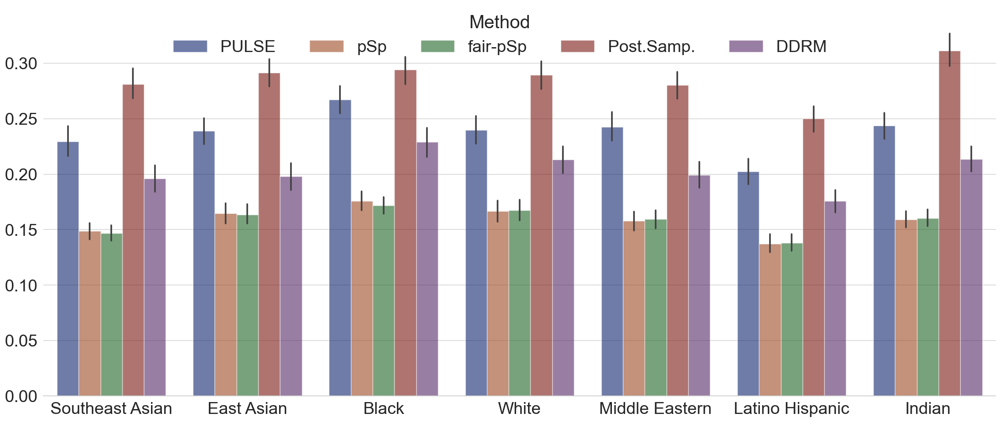

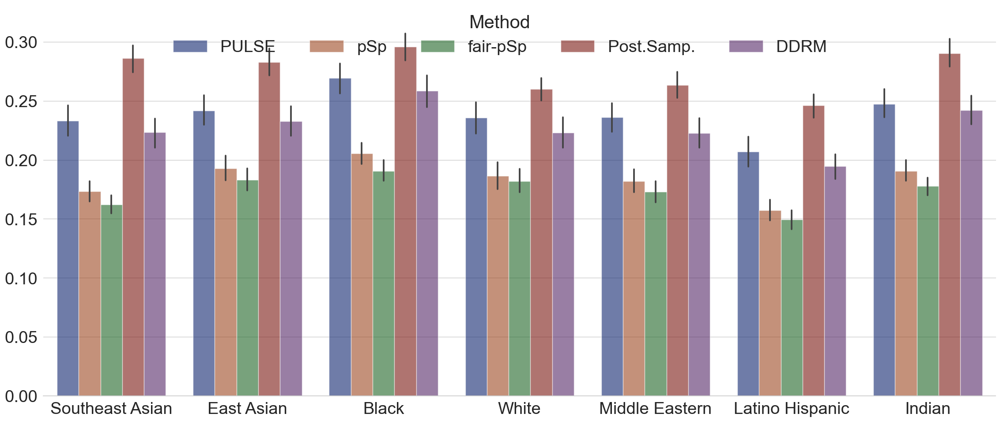

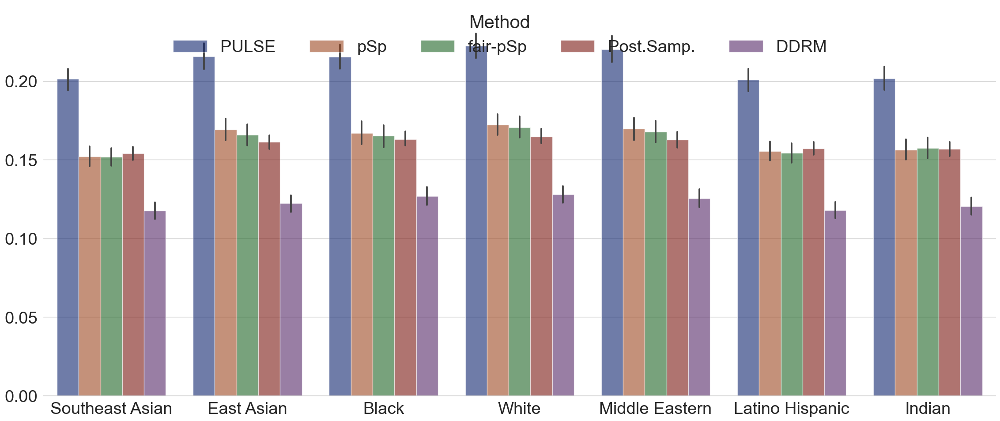

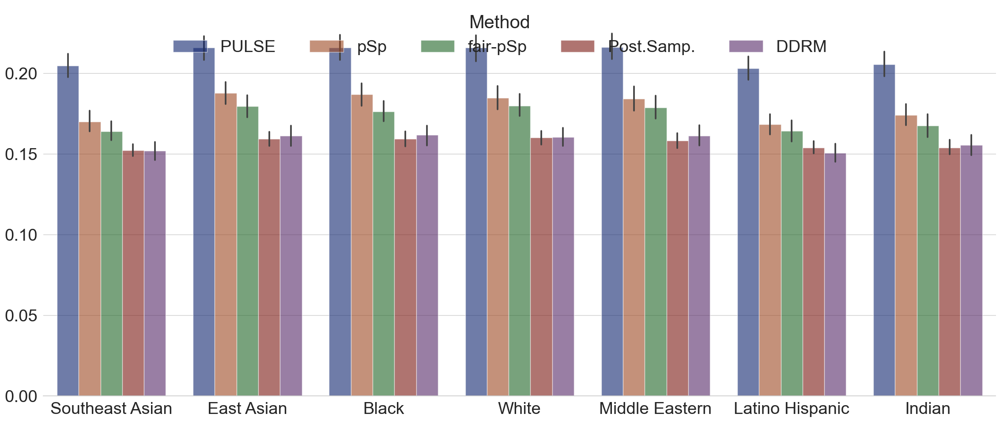

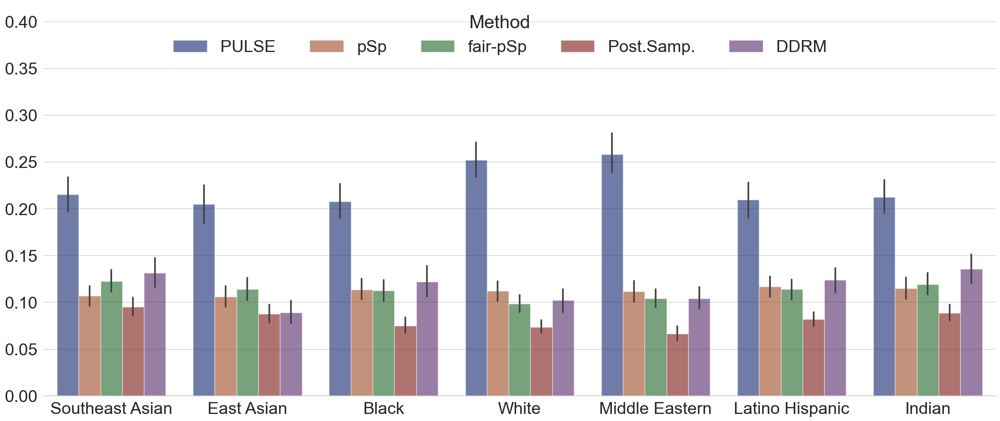

...

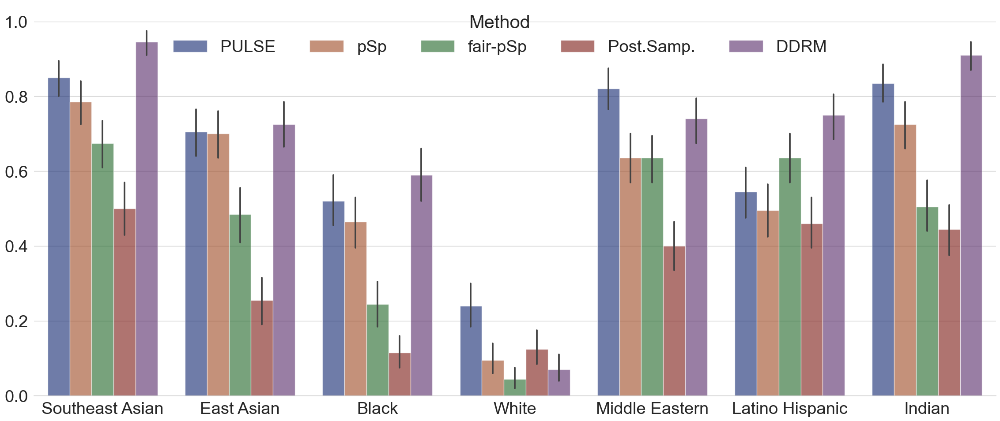

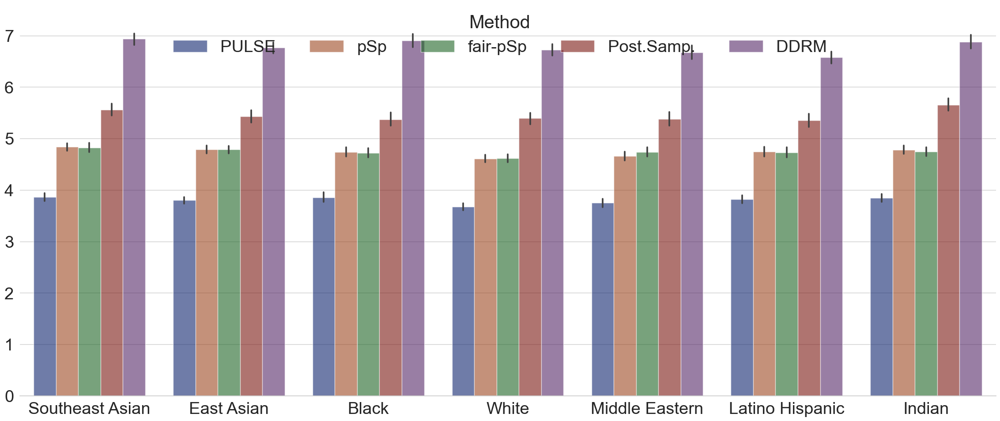

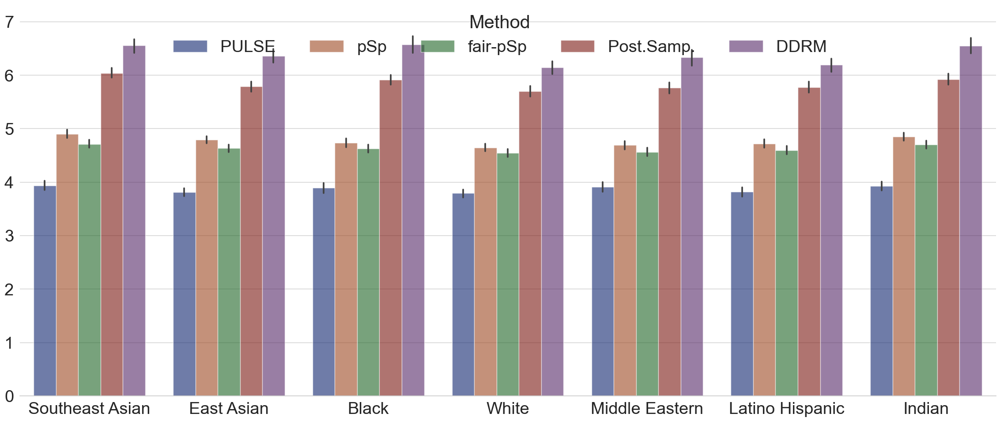

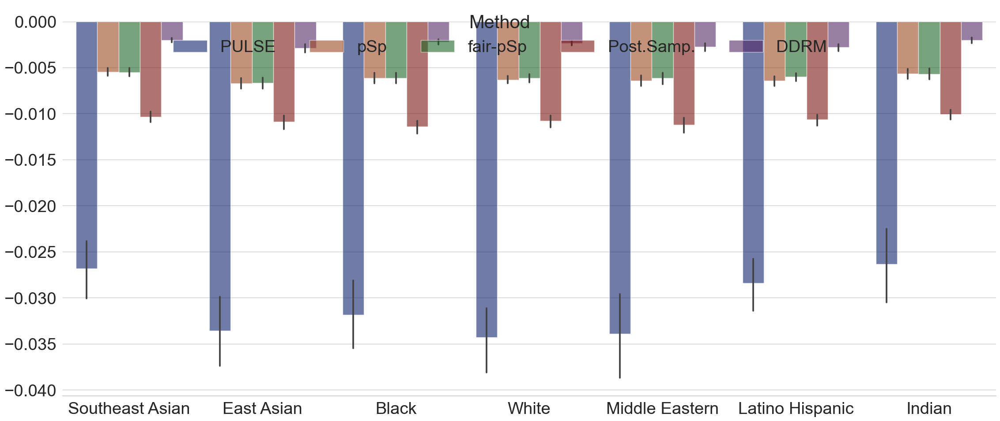

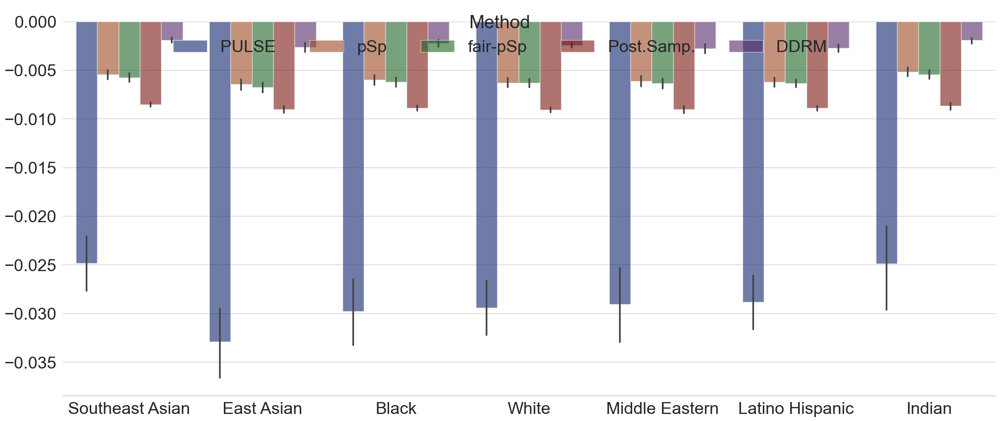

In [44]:
for loss in LOSSES:
    if loss=="race_cos":
        ylim = [0, 0.4]
    elif loss=="race_0-1":
        ylim = [0, 1]
    else:
        ylim = None 
    plot_performance_per_race(loss, dfs, "fairface", methods=METHODS, ylim=ylim)
    plot_performance_per_race(loss, dfs, "unfairface", methods=METHODS, ylim=ylim)

### Rescaling the above (for the race prediction accuracy) provides a visualization of RDP

C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain

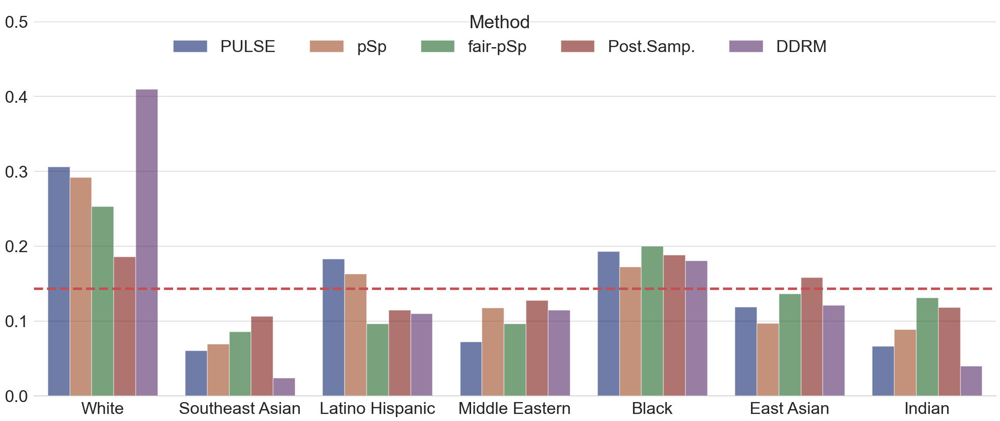

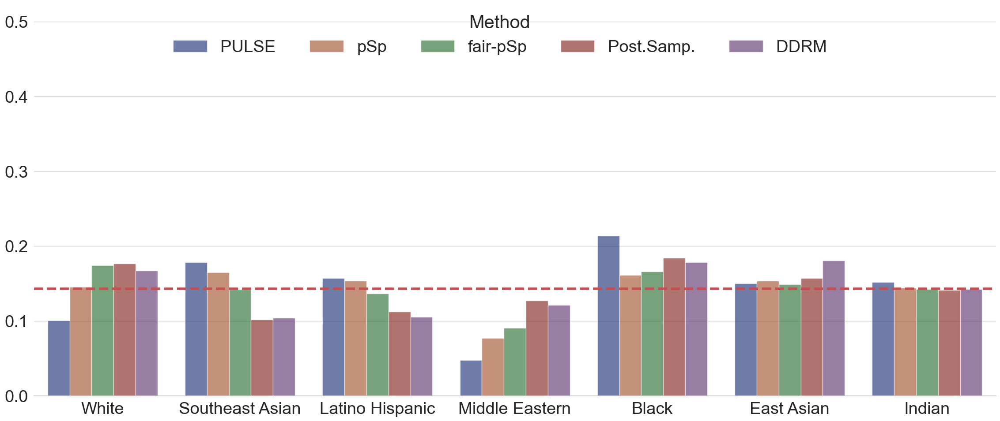

In [45]:
plot_rdp(dfs, "unfairface", methods=METHODS, ylim=[0,0.5])
plot_rdp(dfs, "fairface", methods=METHODS, ylim=[0,0.5])

### 3.3.1 Plotting the Proportional Representation Distribution

C:\Users\hoand\PycharmProjects\ditmeKhoiNguyen\Benchmarking-Fairness-ImageUpsampling\src\visualizations.py:453: UserWarning: The palette list has more values (10) than needed (5), which may not be intended.
  g = sns.histplot(data=loss_df,
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When gr

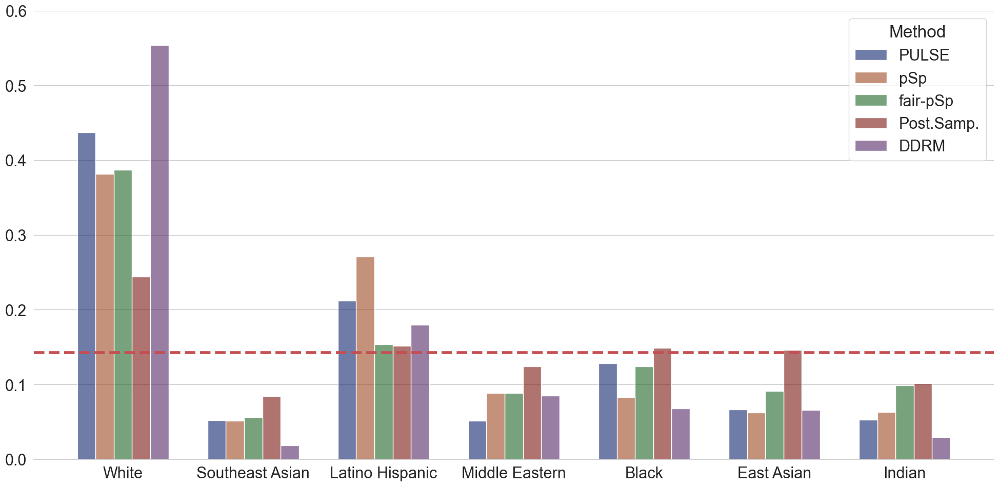

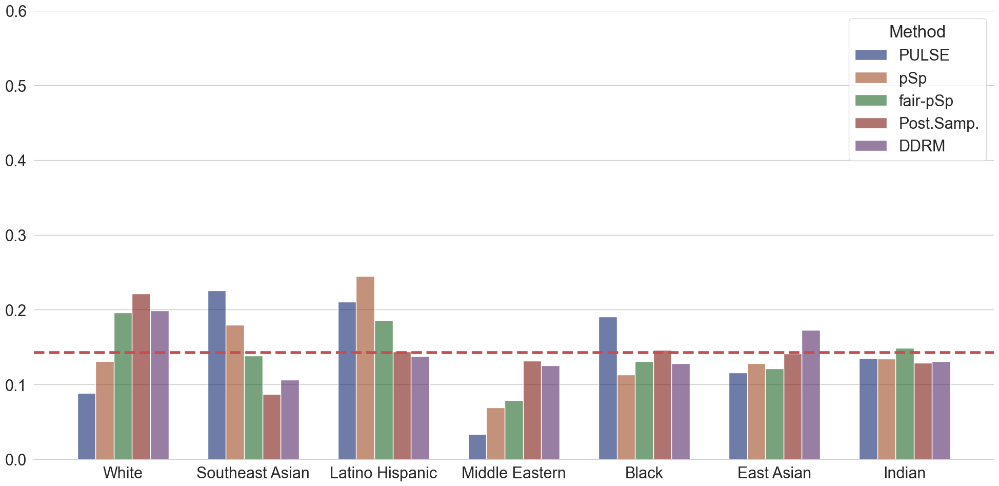

In [46]:
plot_pr(dfs, "unfairface", methods=METHODS, ylim=[0,0.6])
plot_pr(dfs, "fairface", methods=METHODS, ylim=[0, 0.6])

### 3.3.2. Evaluating Fairness according to the introduced Metrics

In [47]:
rdps = compute_RDP(dfs, "fairface", methods=METHODS, races=RACES)
prs = compute_PR(dfs, "fairface", methods=METHODS, races=RACES)

In [48]:
# Evaluation 
divergences = {"KL": kl, "Cheb": cheb, "TV": tv, "chi": chi}

divergences = {"chi": chi, "Cheb": cheb}

def evaluating_fairness(dfs, setting):
    list_fairness = [] 
    rdps = compute_RDP(dfs, setting, methods=METHODS, races=RACES)
    prs = compute_PR(dfs, setting, methods=METHODS, races=RACES)
    for method in METHODS:
        fairness = {"method": name_to_str(method)}
        rdp = rdps[method]
        pr = prs[method]
        for div_name in divergences.keys():
            fairness[f"RDP-{div_name}"] = divergences[div_name](rdp)
        for div_name in divergences.keys():
            fairness[f"PR-{div_name}"] = divergences[div_name](pr)
        list_fairness.append(fairness)
    fairness_df = pd.concat([pd.DataFrame([fairness]) for fairness in list_fairness], ignore_index=True)
    return fairness_df

In [49]:
fairness_unfairface = evaluating_fairness(dfs, "unfairface")
fairness_unfairface

,method,RDP-chi,RDP-Cheb,PR-chi,PR-Cheb
0,PULSE,0.342336,0.162978,0.855114,0.294286
1,pSp,0.242190,0.149078,0.707593,0.238571
2,fair-pSp,0.161396,0.110123,0.526107,0.244286
3,Post.Samp.,0.050000,0.045441,0.111257,0.101429
4,DDRM,0.697869,0.266834,1.493343,0.410714


In [50]:
fairness_fairface = evaluating_fairness(dfs, "fairface")
fairness_fairface 

,method,RDP-chi,RDP-Cheb,PR-chi,PR-Cheb
0,PULSE,0.122295,0.095154,0.206143,0.109286
1,pSp,0.037490,0.065584,0.130000,0.102143
2,fair-pSp,0.030658,0.052601,0.066479,0.064286
3,Post.Samp.,0.041388,0.041135,0.067371,0.078571
4,DDRM,0.046463,0.038480,0.042157,0.055714


In [51]:
# Combine them into one DataFrame 
fairness_both = pd.DataFrame()
fairness_both["method"] = fairness_unfairface["method"]
for label in fairness_unfairface.columns:
    if label == "method":
        continue 
    fairness_both[label] = fairness_unfairface[label]
    fairness_both[f"{label}-F"] = fairness_fairface[label]
print(fairness_both)

       method   RDP-chi  RDP-chi-F  RDP-Cheb  RDP-Cheb-F    PR-chi  PR-chi-F  \
0       PULSE  0.342336   0.122295  0.162978    0.095154  0.855114  0.206143   
1         pSp  0.242190   0.037490  0.149078    0.065584  0.707593  0.130000   
2    fair-pSp  0.161396   0.030658  0.110123    0.052601  0.526107  0.066479   
3  Post.Samp.  0.050000   0.041388  0.045441    0.041135  0.111257  0.067371   
4        DDRM  0.697869   0.046463  0.266834    0.038480  1.493343  0.042157   

    PR-Cheb  PR-Cheb-F  
0  0.294286   0.109286  
1  0.238571   0.102143  
2  0.244286   0.064286  
3  0.101429   0.078571  
4  0.410714   0.055714  


## 3.3.1 Statistically Testing Fairness

In [52]:
testing_fairness(dfs, "unfairface", methods=METHODS, races=RACES, metric="rdp")

,Method,Statistic,P-Value,Reject
0,pulse,223.122253,2.245947e-45,True
1,psp,146.518492,4.211760e-29,True
2,fairpsp,102.373758,8.018129e-20,True
3,posteriorSampling,34.288259,5.917777e-06,True
4,ddrm,401.135610,1.593427e-83,True


In [53]:
testing_fairness(dfs, "fairface", methods=METHODS, races=RACES, metric="rdp")

,Method,Statistic,P-Value,Reject
0,pulse,104.621006,2.720105e-20,True
1,psp,32.017617,1.619121e-05,True
2,fairpsp,23.950916,5.332268e-04,True
3,posteriorSampling,29.348538,5.225821e-05,True
4,ddrm,33.117368,9.954401e-06,True


In [54]:
testing_fairness(dfs, "unfairface", methods=METHODS, races=RACES, metric="pr")

,Method,Statistic,P-Value,Reject
0,pulse,445.472084,4.628247e-93,True
1,psp,396.895623,1.299721e-82,True
2,fairpsp,257.993153,8.023395e-53,True
3,posteriorSampling,70.537331,3.172315e-13,True
4,ddrm,682.679902,3.356075e-144,True


In [55]:
testing_fairness(dfs, "fairface", methods=METHODS, races=RACES, metric="pr")

,Method,Statistic,P-Value,Reject
0,pulse,171.351248,2.324722e-34,True
1,psp,86.578806,1.553969e-16,True
2,fairpsp,49.232459,6.698368e-09,True
3,posteriorSampling,44.509408,5.857318e-08,True
4,ddrm,27.784690,1.031529e-04,True


# 4. Evaluating Diversity

## 4.1. Generate Diversity DataFrames 

In [56]:
def diversity_to_dfs(setting):
    assert setting in ["fairface_avg", "unfairface_avg", "fairface_noisy_avg", "unfairface_noisy_avg"]
    losses_dir = os.path.join("evaluation", setting) 
    os.makedirs(losses_dir, exist_ok=True)
    dfs = {}
    for method in METHODS: 
        losses_path = os.path.join(losses_dir, f"losses_{method}.csv")
        if os.path.exists(losses_path):
            dfs[method] = pd.read_csv(losses_path)
        else:
            if setting in ["fairface_avg", "unfairface_avg"]:
                num_duplicates = 100 
            elif setting in ["fairface_noisy_avg", "unfairface_noisy_avg"]:
                num_duplicates = 1 
            df = compute_diversity(img_paths[setting]["real"], 
                                   img_paths[setting][method], 
                                   labels_path=labels_path, 
                                   num_duplicates=num_duplicates)
            dfs[method] = df
            df.to_csv(losses_path, index=True)
    return dfs 
      
for setting in ["fairface_avg", "unfairface_avg", "fairface_noisy_avg", "unfairface_noisy_avg"]:
    dfs[setting] = diversity_to_dfs(setting)

C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain

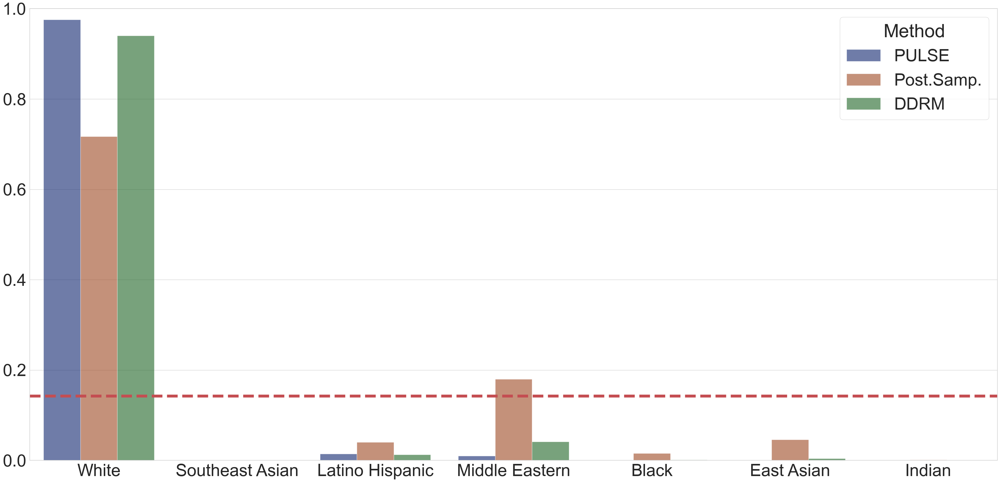

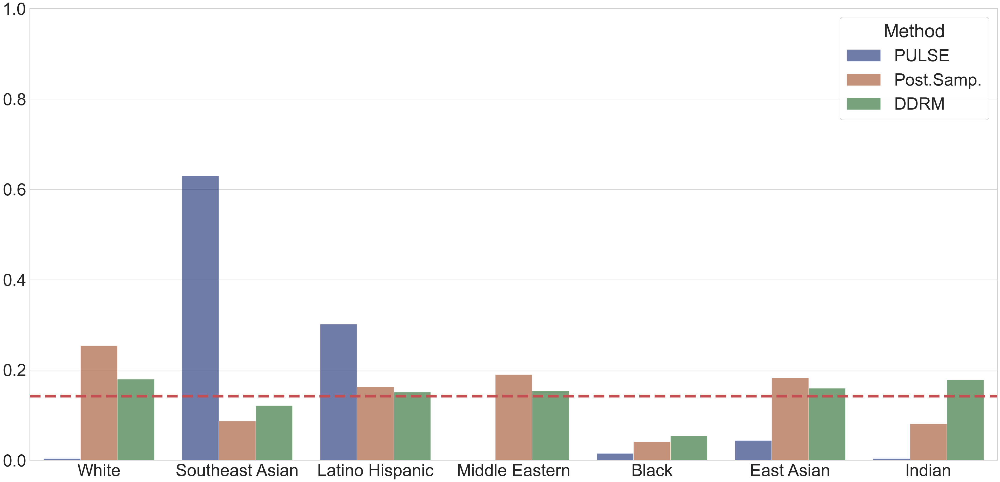

In [57]:
plot_ucpr(dfs, "unfairface_avg", methods=METHODS, races=RACES, ylim=[0, 1.])
plot_ucpr(dfs, "fairface_avg", methods=METHODS, races=RACES, ylim=[0, 1.])

In [58]:
# Evaluation 
divergences = {"KL": kl, "Cheb": cheb, "TV": tv, "chi": chi}
divergences = {"chi": chi, "Cheb": cheb}

def evaluating_diversity(dfs, setting):
    list_diversity = [] 
    ucprs = compute_UCPR(dfs, setting, methods=METHODS, races=RACES)
    for method in METHODS:
        diversity = {"method": name_to_str(method)}
        ucpr = ucprs[method]
        for div_name in divergences.keys():
            diversity[f"UCPR-{div_name}"] = divergences[div_name](ucpr)
        list_diversity.append(diversity)
    diversity_df = pd.concat([pd.DataFrame([fairness]) for fairness in list_diversity], ignore_index=True)
    return diversity_df

In [59]:
diversity_unfairface = evaluating_diversity(dfs, "unfairface_avg")
diversity_unfairface 

,method,UCPR-chi,UCPR-Cheb
0,PULSE,5.666257,0.832857
1,pSp,3.142857,0.571429
2,fair-pSp,1.142857,0.285714
3,Post.Samp.,2.854429,0.574286
4,DDRM,5.198514,0.797143


In [60]:
diversity_fairface = evaluating_diversity(dfs, "fairface_avg")
diversity_fairface 

,method,UCPR-chi,UCPR-Cheb
0,PULSE,2.430029,0.487143
1,pSp,6.000000,0.857143
2,fair-pSp,1.714286,0.285714
3,Post.Samp.,0.236629,0.111429
4,DDRM,0.080200,0.088571


In [61]:
# Combine them into one DataFrame 
diversity_both = pd.DataFrame()
diversity_both["method"] = diversity_unfairface["method"]
for label in diversity_unfairface.columns:
    if label == "method":
        continue 
    diversity_both[label] = diversity_unfairface[label]
    diversity_both[f"{label}-F"] = diversity_fairface[label]
print(diversity_both)

       method  UCPR-chi  UCPR-chi-F  UCPR-Cheb  UCPR-Cheb-F
0       PULSE  5.666257    2.430029   0.832857     0.487143
1         pSp  3.142857    6.000000   0.571429     0.857143
2    fair-pSp  1.142857    1.714286   0.285714     0.285714
3  Post.Samp.  2.854429    0.236629   0.574286     0.111429
4        DDRM  5.198514    0.080200   0.797143     0.088571


## 4.2. Testing Diversity

In [62]:
testing_fairness(dfs, "unfairface_avg", methods=METHODS, races=RACES, metric="ucpr")

,Method,Statistic,P-Value,Reject
0,pulse,1977.107415,0.000000e+00,True
1,psp,1600.000000,0.000000e+00,True
2,fairpsp,866.666667,6.030359e-184,True
3,posteriorSampling,1230.733201,1.067408e-262,True
4,ddrm,1829.832058,0.000000e+00,True


In [63]:
testing_fairness(dfs, "fairface_avg", methods=METHODS, races=RACES, metric="ucpr")

,Method,Statistic,P-Value,Reject
0,pulse,1291.254440,8.471104e-276,True
1,psp,2100.000000,0.000000e+00,True
2,fairpsp,1200.000000,4.786643e-256,True
3,posteriorSampling,183.842702,5.179834e-37,True
4,ddrm,72.003824,1.586002e-13,True


## 4.3. Testing Diversity with Noisy Inputs
Instead of reconstructing each image 100 times, we take one image, calculate 100 perturbed versions of it, and reconstruct these. The advantage is that it allows us to compute a diversity for pSp and fairpSp, whose reconstruction is deterministic. That is, every reconstruction of the same image is the same. This allows us to compute 100 different images even with pSp and fairpSp. 

C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\hoand\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain

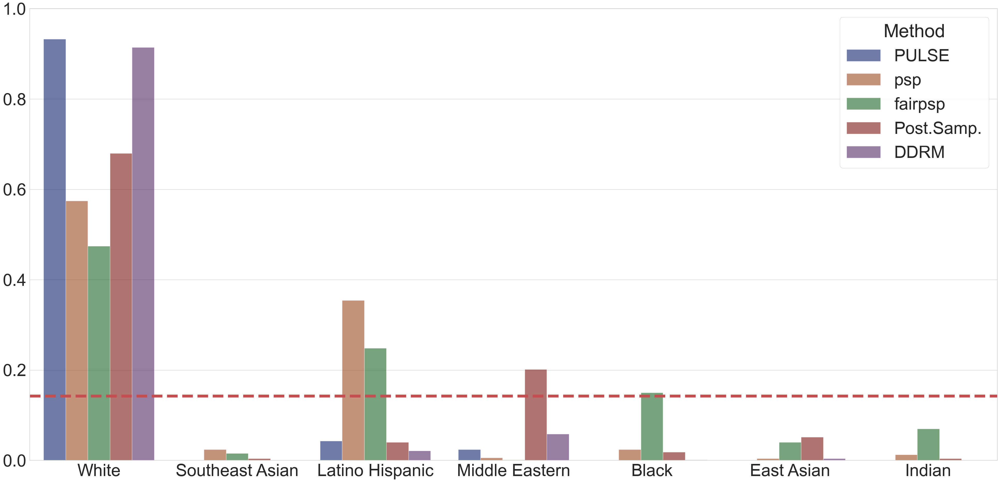

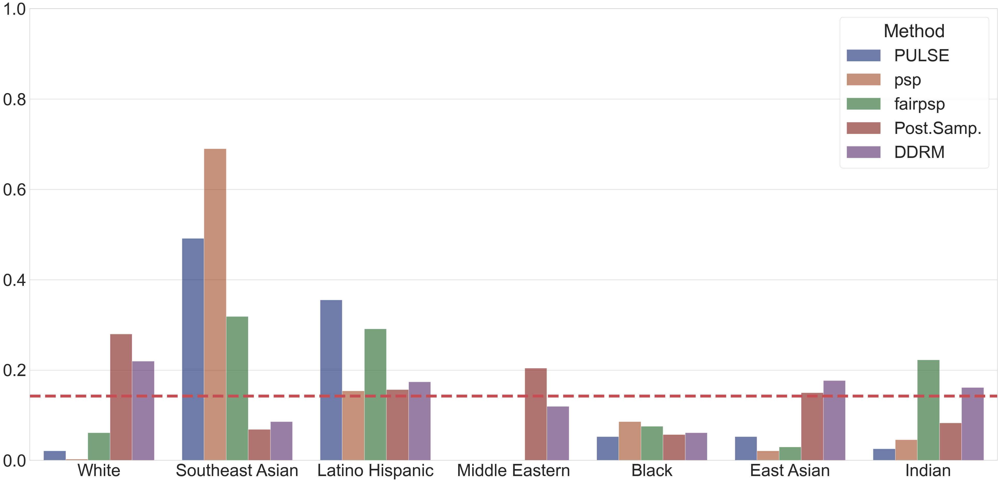

In [64]:
plot_ucpr(dfs, "unfairface_noisy_avg", methods=METHODS, races=RACES, ylim=[0, 1.])
plot_ucpr(dfs, "fairface_noisy_avg", methods=METHODS, races=RACES, ylim=[0, 1.])

In [65]:
diversity_unfairface = evaluating_diversity(dfs, "unfairface_noisy_avg")
diversity_fairface = evaluating_diversity(dfs, "fairface_noisy_avg")

# Combine them into one DataFrame 
diversity_both = pd.DataFrame()
diversity_both["method"] = diversity_unfairface["method"]
for label in diversity_unfairface.columns:
    if label == "method":
        continue 
    diversity_both[label] = diversity_unfairface[label]
    diversity_both[f"{label}-F"] = diversity_fairface[label]
print(diversity_both)

       method  UCPR-chi  UCPR-chi-F  UCPR-Cheb  UCPR-Cheb-F
0       PULSE  5.108543    1.623200   0.790000     0.348571
1         pSp  2.197029    2.568657   0.431429     0.547143
2    fair-pSp  1.211886    0.725429   0.331429     0.175714
3  Post.Samp.  2.553200    0.275114   0.537143     0.137143
4        DDRM  4.878800    0.132143   0.771429     0.081429


In [66]:
testing_fairness(dfs, "unfairface_noisy_avg", methods=METHODS, races=RACES, metric="ucpr")

,Method,Statistic,P-Value,Reject
0,pulse,1805.386999,0.000000e+00,True
1,psp,1235.974298,7.832958e-264,True
2,fairpsp,742.112571,4.925986e-157,True
3,posteriorSampling,1145.437050,3.075204e-244,True
4,ddrm,1739.914406,0.000000e+00,True


In [67]:
testing_fairness(dfs, "fairface_noisy_avg", methods=METHODS, races=RACES, metric="ucpr")

,Method,Statistic,P-Value,Reject
0,pulse,950.908028,3.697934e-202,True
1,psp,1106.980730,6.440923e-236,True
2,fairpsp,566.809315,3.355598e-119,True
3,posteriorSampling,189.589947,3.110060e-38,True
4,ddrm,102.072503,9.267870e-20,True
